# Introduction

The competition is divided into two separate Kaggle competitions, using the same dataset, with the first (M5 Forecasting Competition – Accuracy) requiring 28 days ahead point forecasts and the second (M5 Forecasting Competition – Uncertainty) 28 days ahead probabilistic forecasts for the corresponding median and four prediction intervals (50%, 67%, 95%, and 99%).

* It contains hierarchical sales data, made available by Walmart, starting at the item level and aggregating to that of departments, product categories, stores in three geographical areas of the US: California, Texas, and Wisconsin.

   *  It includes item level, department, product categories and store details for 5 years from 29th Jan 2011 to 24th April 2016 and explanatory variables such as day of the week, price, special events, snap events and festivals. 

  * There are 3049 individual products classified into 3 product categories namely hobbies, household and foods. The products are sold under 7 different departments and in 10 stores in the 3 states. The hierarchical nature of the datasets makes it possible to do a top-down or bottom-up approach. 

    * California has a highest population of 39 million 
    * Texas has a population size of 29 million and 
    * Wisconsin has the lowest population of 5.8 million.

    Each state has store data, categories, department, Items

    For example: TX(3 stores) --> Stores --> Categories(Hobbies, foods, household) --> Departments --> Items


  * We can choose to model the time-series separately for the different states, categories or departments.



* Besides time series data, it also includes explanatory variables such as price, promotions, day of the week, and special events (e.g. Super Bowl, Valentine’s Day, and Orthodox Easter) that affect sales which are used to improve forecasting accuracy.

* The distribution of uncertainty is being assessed by asking participants to provide information on ***four indicative prediction intervals and the median***.

* 

* Instead of having a single competition to estimate both the point forecasts and the uncertainty distribution, there will be two parallel tracks using the same dataset, the first requiring 28 days ahead point forecasts and the second 28 days ahead probabilistic forecasts for the median and four prediction intervals (50%, 67%, 95%, and 99%).


* For the first time, it focuses on series that display intermittency, i.e., sporadic demand including zeros.

There are several factors that may affect sales and **they are day of the week where most customers do their shopping and spending mostly during the weekends, special events or holidays** where there may be a spike in customer purchasing behaviour, product price changes, product categories as products in a typical household like electronic appliances such as TV and smartphones will have few sales compared to food products and finally the location where in states like California, customers spent more whereas in another location customers may be more sensitive to price.

***GOAL*** : The objective of the M5-Forecasting-Accuracy competition is to estimate the daily sales of 3049 products for the next 28 days.

M5 involves the unit sales of various products of different selling volumes and prices that are organized in a hierarchical fashion. This means that, businesswise, in order for a method to perform well, it must provide accurate forecasts across all hierarchical levels, especially for series of high importance, i.e. for series that represent significant sales, measured in US dollars. 

There are 42,840 time series in this data. 


*   Unit sales of product x, aggregated for each store -- 30490
*   Unit sales of product x, aggregated for each State -- 9147
*   Unit sales of product x, aggregated for all stores/states -- 3049
* Unit sales of all products, aggregated for each store and department -- 70
* Unit sales of all products, aggregated for each store and category --	30
* Unit sales of all products, aggregated for each State and department --	21
* Unit sales of all products, aggregated for each State and category --	9
* Unit sales of all products, aggregated for each department	-- 7
* Unit sales of all products, aggregated for each category	-- 3
* Unit sales of all products, aggregated for each store 	-- 10
* Unit sales of all products, aggregated for each State	-- 3
* Unit sales of all products, aggregated for all stores/states	-- 1




The data range from 2011-01-29 to 2016-06-19. Thus, the products have a (maximum) selling history of 1,941  days / 5.4 years (test data of h=28 days not included). 


*   The actual validation data (d_1914 to d_1941) is available in the sales_train_evaluation.csv. Since this file also consists of the entire train data available earlier, we can completely ignore sales_train_validation.csv for the rest of this competition.




Need to predict for the days d_1942 to d_1969 corresponding to the sample submission format F1 to F28.

Evaluation Metrics

*   The evaluation metric of this competition is quite unique.
*   The weights of observations is dependent on historic values of the time series and hence changes for every validation / test dataset.




In [ ]:
## Author Sakami
## thanks to rohan rao
## evaluation metric

class WRMSSEEvaluator(object):

    def __init__(self, train_df: pd.DataFrame, valid_df: pd.DataFrame, calendar: pd.DataFrame, prices: pd.DataFrame):
        train_y = train_df.loc[:, train_df.columns.str.startswith('d_')]
        train_target_columns = train_y.columns.tolist()
        weight_columns = train_y.iloc[:, -28:].columns.tolist()

        train_df['all_id'] = 0  # for lv1 aggregation

        id_columns = train_df.loc[:, ~train_df.columns.str.startswith('d_')].columns.tolist()
        valid_target_columns = valid_df.loc[:, valid_df.columns.str.startswith('d_')].columns.tolist()

        if not all([c in valid_df.columns for c in id_columns]):
            valid_df = pd.concat([train_df[id_columns], valid_df], axis=1, sort=False)

        self.train_df = train_df
        self.valid_df = valid_df
        self.calendar = calendar
        self.prices = prices

        self.weight_columns = weight_columns
        self.id_columns = id_columns
        self.valid_target_columns = valid_target_columns

        weight_df = self.get_weight_df()

        self.group_ids = (
            'all_id',
            'cat_id',
            'state_id',
            'dept_id',
            'store_id',
            'item_id',
            ['state_id', 'cat_id'],
            ['state_id', 'dept_id'],
            ['store_id', 'cat_id'],
            ['store_id', 'dept_id'],
            ['item_id', 'state_id'],
            ['item_id', 'store_id']
        )

        for i, group_id in enumerate(tqdm(self.group_ids)):
            train_y = train_df.groupby(group_id)[train_target_columns].sum()
            scale = []
            for _, row in train_y.iterrows():
                series = row.values[np.argmax(row.values != 0):]
                scale.append(((series[1:] - series[:-1]) ** 2).mean())
            setattr(self, f'lv{i + 1}_scale', np.array(scale))
            setattr(self, f'lv{i + 1}_train_df', train_y)
            setattr(self, f'lv{i + 1}_valid_df', valid_df.groupby(group_id)[valid_target_columns].sum())

            lv_weight = weight_df.groupby(group_id)[weight_columns].sum().sum(axis=1)
            setattr(self, f'lv{i + 1}_weight', lv_weight / lv_weight.sum())

    def get_weight_df(self) -> pd.DataFrame:
        day_to_week = self.calendar.set_index('d')['wm_yr_wk'].to_dict()
        weight_df = self.train_df[['item_id', 'store_id'] + self.weight_columns].set_index(['item_id', 'store_id'])
        weight_df = weight_df.stack().reset_index().rename(columns={'level_2': 'd', 0: 'value'})
        weight_df['wm_yr_wk'] = weight_df['d'].map(day_to_week)

        weight_df = weight_df.merge(self.prices, how='left', on=['item_id', 'store_id', 'wm_yr_wk'])
        weight_df['value'] = weight_df['value'] * weight_df['sell_price']
        weight_df = weight_df.set_index(['item_id', 'store_id', 'd']).unstack(level=2)['value']
        weight_df = weight_df.loc[zip(self.train_df.item_id, self.train_df.store_id), :].reset_index(drop=True)
        weight_df = pd.concat([self.train_df[self.id_columns], weight_df], axis=1, sort=False)
        return weight_df

    def rmsse(self, valid_preds: pd.DataFrame, lv: int) -> pd.Series:
        valid_y = getattr(self, f'lv{lv}_valid_df')
        score = ((valid_y - valid_preds) ** 2).mean(axis=1)
        scale = getattr(self, f'lv{lv}_scale')
        return (score / scale).map(np.sqrt)

    def score(self, valid_preds: Union[pd.DataFrame, np.ndarray]):
        assert self.valid_df[self.valid_target_columns].shape == valid_preds.shape

        if isinstance(valid_preds, np.ndarray):
            valid_preds = pd.DataFrame(valid_preds, columns=self.valid_target_columns)

        valid_preds = pd.concat([self.valid_df[self.id_columns], valid_preds], axis=1, sort=False)

        group_ids = []
        all_scores = []
        for i, group_id in enumerate(self.group_ids):
            lv_scores = self.rmsse(valid_preds.groupby(group_id)[self.valid_target_columns].sum(), i + 1)
            weight = getattr(self, f'lv{i + 1}_weight')
            lv_scores = pd.concat([weight, lv_scores], axis=1, sort=False).prod(axis=1)
            group_ids.append(group_id)
            all_scores.append(lv_scores.sum())

        return group_ids, all_scores

EDA pointers

1. Total sales per state
2. Total sales per store in different states
3. Total available products in different departments
4. Distribution of item prices wrt stores across categories
5. Yearly sales (heat map)
6. Unit sales time series per month -- state wise
7. 



# Installing CUDF


# Imports


In [ ]:
!pip install calmap
!pip install calplot
!pip install seaborn
!pip install 'fsspec>=0.3.3'
!pip install dask
!pip install dask_xgboost

In [ ]:
# Critical imports

import pandas as pd
import numpy as np
import plotly.graph_objects as go
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
#import calmap
#import calplot
from tqdm import tqdm
from pandas.testing import assert_frame_equal

import warnings
warnings.filterwarnings('ignore')
import dask.dataframe as dd
pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)

import lightgbm as lgb
import dask_xgboost as xgb
import dask.dataframe as dd
from sklearn import preprocessing, metrics
import gc
import os



/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



# EDA

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
%cd /content/drive/My Drive/projects/m5-forecasting

/content/drive/My Drive/projects/m5-forecasting


Contains information about the dates on which the products are sold.

- *date*: The date in a “y-m-d” format.
- ***`wm_yr_wk*: The id of the week the date belongs to.`**
- *weekday*: The type of the day (Saturday, Sunday, …, Friday).
- *wday*: The id of the weekday, starting from Saturday.
- *month*: The month of the date.
- *year*: The year of the date.
- *event_name_1*: If the date includes an event, the name of this event.
- *event_type_1*: If the date includes an event, the type of this event.
- *event_name_2*: If the date includes a second event, the name of this event.
- *event_type_2*: If the date includes a second event, the type of this event.
- *snap_CA*, *snap_TX*, and *snap_WI*: A binary variable (0 or 1) indicating whether the stores of CA, TX or WI allow SNAP[[2]](notion://www.notion.so/M5-forecasting-competition-a6470b26044843429e960b260a3cc80a#_ftn2) purchases on the examined date. 1 indicates that SNAP purchases are allowed.

In [ ]:
df_cal = pd.read_csv('/content/drive/My Drive/projects/m5-forecasting/calendar.csv')
df_train_sales_valid = pd.read_csv('/content/drive/My Drive/projects/m5-forecasting/sales_train_validation.csv')
df_train_sales_eval = pd.read_csv('/content/drive/My Drive/projects/m5-forecasting/sales_train_evaluation.csv')
df_prices = pd.read_csv('/content/drive/My Drive/projects/m5-forecasting/sell_prices.csv')
df_submission = pd.read_csv('/content/drive/My Drive/projects/m5-forecasting/sample_submission.csv')

From the above dataframe: 

weekday, Workday, month, year, data_number(d), event_name, 
event_type (2 columns for each), 
snap (i.e. is today a snap day for the current store)

Contains the historical daily unit sales data per product and store

Contains information about the price of the products sold per store and date.

- *store_id*: The id of the store where the product is sold.**[sales_train.csv]**
- *item_id*: The id of the product. **[sales_train.csv]**
- *wm_yr_wk*: The id of the week. **[calender.csv]**
- *sell_price*: The price of the product for the given week/store. The price is provided per week (average across seven days). If not available, this means that the product was not sold during the examined week. Note that although prices are constant at weekly basis, they may change through time (both training and test set).

In [ ]:
df_prices['state']=df_prices.store_id.str[:2]
df_prices['item']=df_prices.item_id.str[:-6]
df_prices['items']=df_prices.item_id.str[:-4]
df_prices['items_ids']=df_prices.item_id.str[-3:]
df_prices.dropna()
df_prices

,store_id,item_id,wm_yr_wk,sell_price,state,item,items,items_ids
0,CA_1,HOBBIES_1_001,11325,9.58,CA,HOBBIES,HOBBIES_1,001
1,CA_1,HOBBIES_1_001,11326,9.58,CA,HOBBIES,HOBBIES_1,001
2,CA_1,HOBBIES_1_001,11327,8.26,CA,HOBBIES,HOBBIES_1,001
3,CA_1,HOBBIES_1_001,11328,8.26,CA,HOBBIES,HOBBIES_1,001
4,CA_1,HOBBIES_1_001,11329,8.26,CA,HOBBIES,HOBBIES_1,001
...,...,...,...,...,...,...,...,...
6841116,WI_3,FOODS_3_827,11617,1.00,WI,FOODS,FOODS_3,827
6841117,WI_3,FOODS_3_827,11618,1.00,WI,FOODS,FOODS_3,827
6841118,WI_3,FOODS_3_827,11619,1.00,WI,FOODS,FOODS_3,827
6841119,WI_3,FOODS_3_827,11620,1.00,WI,FOODS,FOODS_3,827


SO, I have 6,841,121 - items sold in three states across all 

In [ ]:
#another way to see this -- but not efficient
#df_cal[df_cal['event_name_1'].notna()]
#df_cal[df_cal['event_name_2'].notna()]

#best way
df_cal.dropna(how='all', subset=['event_name_1', 'event_name_2'])

,date,wm_yr_wk,weekday,wday,month,year,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI
8,2011-02-06,11102,Sunday,2,2,2011,d_9,SuperBowl,Sporting,NaN,NaN,1,1,1
16,2011-02-14,11103,Monday,3,2,2011,d_17,ValentinesDay,Cultural,NaN,NaN,0,0,1
23,2011-02-21,11104,Monday,3,2,2011,d_24,PresidentsDay,National,NaN,NaN,0,0,0
39,2011-03-09,11106,Wednesday,5,3,2011,d_40,LentStart,Religious,NaN,NaN,1,1,1
46,2011-03-16,11107,Wednesday,5,3,2011,d_47,LentWeek2,Religious,NaN,NaN,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1926,2016-05-08,11615,Sunday,2,5,2016,d_1927,Mother's day,Cultural,NaN,NaN,1,0,1
1948,2016-05-30,11618,Monday,3,5,2016,d_1949,MemorialDay,National,NaN,NaN,0,0,0
1951,2016-06-02,11618,Thursday,6,6,2016,d_1952,NBAFinalsStart,Sporting,NaN,NaN,1,0,1
1956,2016-06-07,11619,Tuesday,4,6,2016,d_1957,Ramadan starts,Religious,NaN,NaN,1,1,0


In [ ]:
df_event_1 = df_cal[['date','event_name_1', 'event_type_1']]
#df_event_1['event_type_1'] = df_event_1['event_type_1'].replace(['Cultural', 'Religious'], ['Cultural_1','Religious_1'])
df_event_1["event_type_1"].replace({"Cultural": "Cultural_1", "Religious": "Religious_1"}, inplace=True)
df_event_1 = df_event_1.dropna()
df_event_1.pivot(index='date', columns='event_type_1', values='event_name_1')

/usr/local/lib/python3.6/dist-packages/pandas/core/generic.py:6746: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



event_type_1,Cultural_1,National,Religious_1,Sporting
date,,,,
2011-02-06,NaN,NaN,NaN,SuperBowl
2011-02-14,ValentinesDay,NaN,NaN,NaN
2011-02-21,NaN,PresidentsDay,NaN,NaN
2011-03-09,NaN,NaN,LentStart,NaN
2011-03-16,NaN,NaN,LentWeek2,NaN
...,...,...,...,...
2016-05-08,Mother's day,NaN,NaN,NaN
2016-05-30,NaN,MemorialDay,NaN,NaN
2016-06-02,NaN,NaN,NaN,NBAFinalsStart


In [ ]:
df_event_2 = df_cal[['date','event_name_2', 'event_type_2']]
df_event_2["event_type_2"].replace({"Cultural": "Cultural_2", "Religious": "Religious_2"}, inplace=True)
df_event_2 = df_event_2.dropna()
df_event_2.pivot(index='date', columns='event_type_2', values='event_name_2')

/usr/local/lib/python3.6/dist-packages/pandas/core/generic.py:6746: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



event_type_2,Cultural_2,Religious_2
date,,
2011-04-24,Easter,NaN
2013-05-05,Cinco De Mayo,NaN
2014-04-20,NaN,OrthodoxEaster
2014-06-15,Father's day,NaN
2016-06-19,Father's day,NaN


In [ ]:
frames = [df_event_1, df_event_2]
df_events = pd.concat(frames)
df_events

,date,event_name_1,event_type_1,event_name_2,event_type_2
8,2011-02-06,SuperBowl,Sporting,NaN,NaN
16,2011-02-14,ValentinesDay,Cultural_1,NaN,NaN
23,2011-02-21,PresidentsDay,National,NaN,NaN
39,2011-03-09,LentStart,Religious_1,NaN,NaN
46,2011-03-16,LentWeek2,Religious_1,NaN,NaN
...,...,...,...,...,...
85,2011-04-24,NaN,NaN,Easter,Cultural_2
827,2013-05-05,NaN,NaN,Cinco De Mayo,Cultural_2
1177,2014-04-20,NaN,NaN,OrthodoxEaster,Religious_2
1233,2014-06-15,NaN,NaN,Father's day,Cultural_2


In [ ]:
df_train_sales_valid

,id,item_id,dept_id,cat_id,store_id,state_id,d_1,d_2,d_3,d_4,d_5,d_6,d_7,d_8,d_9,d_10,d_11,d_12,d_13,d_14,d_15,d_16,d_17,d_18,d_19,d_20,d_21,d_22,d_23,d_24,d_25,d_26,d_27,d_28,d_29,d_30,d_31,d_32,d_33,d_34,d_35,d_36,d_37,d_38,d_39,d_40,d_41,d_42,d_43,d_44,d_45,d_46,d_47,d_48,d_49,d_50,d_51,d_52,d_53,d_54,d_55,d_56,d_57,d_58,d_59,d_60,d_61,d_62,d_63,d_64,d_65,d_66,d_67,d_68,d_69,d_70,d_71,d_72,d_73,d_74,d_75,d_76,d_77,d_78,d_79,d_80,d_81,d_82,d_83,d_84,d_85,d_86,d_87,d_88,d_89,d_90,d_91,d_92,d_93,d_94,d_95,d_96,d_97,d_98,d_99,d_100,d_101,d_102,d_103,d_104,d_105,d_106,d_107,d_108,d_109,d_110,d_111,d_112,d_113,d_114,d_115,d_116,d_117,d_118,d_119,d_120,d_121,d_122,d_123,d_124,d_125,d_126,d_127,d_128,d_129,d_130,d_131,d_132,d_133,d_134,d_135,d_136,d_137,d_138,d_139,d_140,d_141,d_142,d_143,d_144,d_145,d_146,d_147,d_148,d_149,d_150,d_151,d_152,d_153,d_154,d_155,d_156,d_157,d_158,d_159,d_160,d_161,d_162,d_163,d_164,d_165,d_166,d_167,d_168,d_169,d_170,d_171,d_172,d_173,d_174,d_175,d_176,d_177,d_178,d_179,d_180,d_181,d_182,d_183,d_184,d_185,d_186,d_187,d_188,d_189,d_190,d_191,d_192,d_193,d_194,d_195,d_196,d_197,d_198,d_199,d_200,d_201,d_202,d_203,d_204,d_205,d_206,d_207,d_208,d_209,d_210,d_211,d_212,d_213,d_214,d_215,d_216,d_217,d_218,d_219,d_220,d_221,d_222,d_223,d_224,d_225,d_226,d_227,d_228,d_229,d_230,d_231,d_232,d_233,d_234,d_235,d_236,d_237,d_238,d_239,d_240,d_241,d_242,d_243,d_244,...,d_1664,d_1665,d_1666,d_1667,d_1668,d_1669,d_1670,d_1671,d_1672,d_1673,d_1674,d_1675,d_1676,d_1677,d_1678,d_1679,d_1680,d_1681,d_1682,d_1683,d_1684,d_1685,d_1686,d_1687,d_1688,d_1689,d_1690,d_1691,d_1692,d_1693,d_1694,d_1695,d_1696,d_1697,d_1698,d_1699,d_1700,d_1701,d_1702,d_1703,d_1704,d_1705,d_1706,d_1707,d_1708,d_1709,d_1710,d_1711,d_1712,d_1713,d_1714,d_1715,d_1716,d_1717,d_1718,d_1719,d_1720,d_1721,d_1722,d_1723,d_1724,d_1725,d_1726,d_1727,d_1728,d_1729,d_1730,d_1731,d_1732,d_1733,d_1734,d_1735,d_1736,d_1737,d_1738,d_1739,d_1740,d_1741,d_1742,d_1743,d_1744,d_1745,d_1746,d_1747,d_1748,d_1749,d_1750,d_1751,d_1752,d_1753,d_1754,d_1755,d_1756,d_1757,d_1758,d_1759,d_1760,d_1761,d_1762,d_1763,d_1764,d_1765,d_1766,d_1767,d_1768,d_1769,d_1770,d_1771,d_1772,d_1773,d_1774,d_1775,d_1776,d_1777,d_1778,d_1779,d_1780,d_1781,d_1782,d_1783,d_1784,d_1785,d_1786,d_1787,d_1788,d_1789,d_1790,d_1791,d_1792,d_1793,d_1794,d_1795,d_1796,d_1797,d_1798,d_1799,d_1800,d_1801,d_1802,d_1803,d_1804,d_1805,d_1806,d_1807,d_1808,d_1809,d_1810,d_1811,d_1812,d_1813,d_1814,d_1815,d_1816,d_1817,d_1818,d_1819,d_1820,d_1821,d_1822,d_1823,d_1824,d_1825,d_1826,d_1827,d_1828,d_1829,d_1830,d_1831,d_1832,d_1833,d_1834,d_1835,d_1836,d_1837,d_1838,d_1839,d_1840,d_1841,d_1842,d_1843,d_1844,d_1845,d_1846,d_1847,d_1848,d_1849,d_1850,d_1851,d_1852,d_1853,d_1854,d_1855,d_1856,d_1857,d_1858,d_1859,d_1860,d_1861,d_1862,d_1863,d_1864,d_1865,d_1866,d_1867,d_1868,d_1869,d_1870,d_1871,d_1872,d_1873,d_1874,d_1875,d_1876,d_1877,d_1878,d_1879,d_1880,d_1881,d_1882,d_1883,d_1884,d_1885,d_1886,d_1887,d_1888,d_1889,d_1890,d_1891,d_1892,d_1893,d_1894,d_1895,d_1896,d_1897,d_1898,d_1899,d_1900,d_1901,d_1902,d_1903,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913
0,HOBBIES_1_001_CA_1_validation,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,0,0,2,0,2,2,0,0,0,1,1,0,2,0,1,1,2,0,1,0,0,0,2,1,0,1,1,2,0,0,0,0,0,0,0,1,0,1,0,1,0,3,1,1,0,1,1,2,0,0,0,0,1,1,0,0,0,0,3,0,1,0,0,0,0,1,1,1,0,1,0,2,0,0,0,0,2,0,0,0,0,1,1,2,0,0,0,0,2,0,0,1,1,1,1,0,0,0,0,0,1,2,2,0,1,0,0,0,0,1,2,1,0,0,0,0,0,1,0,3,0,1,2,1,0,3,0,0,0,1,0,2,2,1,0,0,1,2,0,1

In [ ]:
df_train_sales_eval


,id,item_id,dept_id,cat_id,store_id,state_id,d_1,d_2,d_3,d_4,d_5,d_6,d_7,d_8,d_9,d_10,d_11,d_12,d_13,d_14,d_15,d_16,d_17,d_18,d_19,d_20,d_21,d_22,d_23,d_24,d_25,d_26,d_27,d_28,d_29,d_30,d_31,d_32,d_33,d_34,d_35,d_36,d_37,d_38,d_39,d_40,d_41,d_42,d_43,d_44,d_45,d_46,d_47,d_48,d_49,d_50,d_51,d_52,d_53,d_54,d_55,d_56,d_57,d_58,d_59,d_60,d_61,d_62,d_63,d_64,d_65,d_66,d_67,d_68,d_69,d_70,d_71,d_72,d_73,d_74,d_75,d_76,d_77,d_78,d_79,d_80,d_81,d_82,d_83,d_84,d_85,d_86,d_87,d_88,d_89,d_90,d_91,d_92,d_93,d_94,d_95,d_96,d_97,d_98,d_99,d_100,d_101,d_102,d_103,d_104,d_105,d_106,d_107,d_108,d_109,d_110,d_111,d_112,d_113,d_114,d_115,d_116,d_117,d_118,d_119,d_120,d_121,d_122,d_123,d_124,d_125,d_126,d_127,d_128,d_129,d_130,d_131,d_132,d_133,d_134,d_135,d_136,d_137,d_138,d_139,d_140,d_141,d_142,d_143,d_144,d_145,d_146,d_147,d_148,d_149,d_150,d_151,d_152,d_153,d_154,d_155,d_156,d_157,d_158,d_159,d_160,d_161,d_162,d_163,d_164,d_165,d_166,d_167,d_168,d_169,d_170,d_171,d_172,d_173,d_174,d_175,d_176,d_177,d_178,d_179,d_180,d_181,d_182,d_183,d_184,d_185,d_186,d_187,d_188,d_189,d_190,d_191,d_192,d_193,d_194,d_195,d_196,d_197,d_198,d_199,d_200,d_201,d_202,d_203,d_204,d_205,d_206,d_207,d_208,d_209,d_210,d_211,d_212,d_213,d_214,d_215,d_216,d_217,d_218,d_219,d_220,d_221,d_222,d_223,d_224,d_225,d_226,d_227,d_228,d_229,d_230,d_231,d_232,d_233,d_234,d_235,d_236,d_237,d_238,d_239,d_240,d_241,d_242,d_243,d_244,...,d_1692,d_1693,d_1694,d_1695,d_1696,d_1697,d_1698,d_1699,d_1700,d_1701,d_1702,d_1703,d_1704,d_1705,d_1706,d_1707,d_1708,d_1709,d_1710,d_1711,d_1712,d_1713,d_1714,d_1715,d_1716,d_1717,d_1718,d_1719,d_1720,d_1721,d_1722,d_1723,d_1724,d_1725,d_1726,d_1727,d_1728,d_1729,d_1730,d_1731,d_1732,d_1733,d_1734,d_1735,d_1736,d_1737,d_1738,d_1739,d_1740,d_1741,d_1742,d_1743,d_1744,d_1745,d_1746,d_1747,d_1748,d_1749,d_1750,d_1751,d_1752,d_1753,d_1754,d_1755,d_1756,d_1757,d_1758,d_1759,d_1760,d_1761,d_1762,d_1763,d_1764,d_1765,d_1766,d_1767,d_1768,d_1769,d_1770,d_1771,d_1772,d_1773,d_1774,d_1775,d_1776,d_1777,d_1778,d_1779,d_1780,d_1781,d_1782,d_1783,d_1784,d_1785,d_1786,d_1787,d_1788,d_1789,d_1790,d_1791,d_1792,d_1793,d_1794,d_1795,d_1796,d_1797,d_1798,d_1799,d_1800,d_1801,d_1802,d_1803,d_1804,d_1805,d_1806,d_1807,d_1808,d_1809,d_1810,d_1811,d_1812,d_1813,d_1814,d_1815,d_1816,d_1817,d_1818,d_1819,d_1820,d_1821,d_1822,d_1823,d_1824,d_1825,d_1826,d_1827,d_1828,d_1829,d_1830,d_1831,d_1832,d_1833,d_1834,d_1835,d_1836,d_1837,d_1838,d_1839,d_1840,d_1841,d_1842,d_1843,d_1844,d_1845,d_1846,d_1847,d_1848,d_1849,d_1850,d_1851,d_1852,d_1853,d_1854,d_1855,d_1856,d_1857,d_1858,d_1859,d_1860,d_1861,d_1862,d_1863,d_1864,d_1865,d_1866,d_1867,d_1868,d_1869,d_1870,d_1871,d_1872,d_1873,d_1874,d_1875,d_1876,d_1877,d_1878,d_1879,d_1880,d_1881,d_1882,d_1883,d_1884,d_1885,d_1886,d_1887,d_1888,d_1889,d_1890,d_1891,d_1892,d_1893,d_1894,d_1895,d_1896,d_1897,d_1898,d_1899,d_1900,d_1901,d_1902,d_1903,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913,d_1914,d_1915,d_1916,d_1917,d_1918,d_1919,d_1920,d_1921,d_1922,d_1923,d_1924,d_1925,d_1926,d_1927,d_1928,d_1929,d_1930,d_1931,d_1932,d_1933,d_1934,d_1935,d_1936,d_1937,d_1938,d_1939,d_1940,d_1941
0,HOBBIES_1_001_CA_1_evaluation,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,1,0,1,0,1,0,3,1,1,0,1,1,2,0,0,0,0,1,1,0,0,0,0,3,0,1,0,0,0,0,1,1,1,0,1,0,2,0,0,0,0,2,0,0,0,0,1,1,2,0,0,0,0,2,0,0,1,1,1,1,0,0,0,0,0,1,2,2,0,1,0,0,0,0,1,2,1,0,0,0,0,0,1,0,3,0,1,2,1,0,3,0,0,0,1,0,2,2,1,0,0,1,2,0,1,0,1,4,0,0,5,0,0,0,0,0,0,2,1,2,1,0,0,0,1,1,1,0,0,1,1,1,1

In [ ]:
df_submission

,id,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,F15,F16,F17,F18,F19,F20,F21,F22,F23,F24,F25,F26,F27,F28
0,Total_X_0.005_validation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,CA_X_0.005_validation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,TX_X_0.005_validation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,WI_X_0.005_validation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,CA_1_X_0.005_validation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
771115,FOODS_3_823_WI_3_0.995_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
771116,FOODS_3_824_WI_3_0.995_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
771117,FOODS_3_825_WI_3_0.995_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
771118,FOODS_3_826_WI_3_0.995_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


# Finding for highest selling items across all three states

In [ ]:
CA1 = len(df_prices[df_prices['store_id'] == 'CA_1'])
CA2 = len(df_prices[df_prices['store_id'] == 'CA_2'])
CA3 = len(df_prices[df_prices['store_id'] == 'CA_3'])
CA4 = len(df_prices[df_prices['store_id'] == 'CA_4'])
TX1 = len(df_prices[df_prices['store_id'] == 'TX_1'])
TX2 = len(df_prices[df_prices['store_id'] == 'TX_2'])
TX3 = len(df_prices[df_prices['store_id'] == 'TX_3'])
WI1 = len(df_prices[df_prices['store_id'] == 'WI_1'])
WI2 = len(df_prices[df_prices['store_id'] == 'WI_2'])
WI3 = len(df_prices[df_prices['store_id'] == 'WI_3'])


In [ ]:
import plotly.express as px

fig = go.Figure([go.Bar(x=['CA', 'TX', 'WI'], y = [CA1+CA2+CA3+CA4, TX1+TX2+TX3, WI1+WI2+WI3])])
fig.update_layout(title={'text': "Total sales in each state", 'y':0.9, 'x':0.5,
                         'xanchor': 'center', 'yanchor': 'top'}, 
                  yaxis_title="Number of Items", font=dict(size=18,))
fig.update_traces(marker_color=px.colors.qualitative.Dark24)
fig.show()

In [ ]:
a = [len(df_prices[(df_prices['item_id'].str.contains('HOBBIES')) & (df_prices['state'] == 'CA')]),
     len(df_prices[(df_prices['item_id'].str.contains('HOBBIES')) & (df_prices['state'] == 'TX')]),
     len(df_prices[(df_prices['item_id'].str.contains('HOBBIES')) & (df_prices['state'] == 'WI')])]
b = [len(df_prices[(df_prices['item_id'].str.contains('HOUSEHOLD')) & (df_prices['state'] == 'CA')]),
     len(df_prices[(df_prices['item_id'].str.contains('HOUSEHOLD')) & (df_prices['state'] == 'TX')]),
     len(df_prices[(df_prices['item_id'].str.contains('HOUSEHOLD')) & (df_prices['state'] == 'WI')])]
c = [len(df_prices[(df_prices['item_id'].str.contains('FOODS')) & (df_prices['state'] == 'CA')]),
     len(df_prices[(df_prices['item_id'].str.contains('FOODS')) & (df_prices['state'] == 'TX')]),
     len(df_prices[(df_prices['item_id'].str.contains('FOODS')) & (df_prices['state'] == 'WI')])]

In [ ]:
import plotly.graph_objects as go

states = ['CA', "TX", 'WI']


fig = go.Figure(data=[
    go.Bar(name='Hobbies', x=states, y=a),
    go.Bar(name='Household', x=states, y=b),
    go.Bar(name='Foods', x=states, y=c)
])

fig.update_layout(
    title={
        'text': "Total Sales of each product in each state",
        'y':0.9,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'},
    #xaxis_title="X Axis Title",
    yaxis_title="Number of Items",
    font=dict(size=18,))


# Change the bar mode
fig.update_layout(barmode='group')
fig.show()

From above plot, I can see that foods are highest selling items across all three states and CA state has higher items selling across all items. Having 4 stores and more population, this trend can be expected.
Have check with population density and draw more conclusion.

Now let us how many items each store is selling

In [ ]:
import plotly.express as px

fig = go.Figure([go.Bar(x=df_prices.store_id.unique().tolist(), y = [CA1, CA2, CA3, CA4, TX1, TX2, TX3, WI1, WI2, WI3])])
fig.update_traces(marker_color=px.colors.qualitative.Dark24)
fig.update_layout(title={'text': "Total sales of each store", 'y':0.9, 'x':0.5,
                         'xanchor': 'center', 'yanchor': 'top'}, 
                  yaxis_title="Number of Items", font=dict(size=18,))
fig.show()


From the above graphs, we can see that CA has more items sold among the three. But texas has also more items when viewed as 3 stores selling

# How many different products are available in each department?

This section aims to answer:

* How many different products are available in each department?
* What is the mean price of all the available products across different states?
* Which department has the highest and least sales?

In [ ]:
df_prices['items'].unique()

array(['HOBBIES_1', 'HOBBIES_2', 'HOUSEHOLD_1', 'HOUSEHOLD_2', 'FOODS_1',
       'FOODS_2', 'FOODS_3'], dtype=object)

In [ ]:
import plotly.graph_objects as go


df_01 = df_prices[df_prices['state'] == 'CA']
df_02 = df_prices[df_prices['state'] == 'TX']
df_03 = df_prices[df_prices['state'] == 'WI']

def product_dept(df):
  hobbies_1 = len(df[(df['item_id'].str.contains('HOBBIES_1'))])
  hobbies_2 = len(df[(df['item_id'].str.contains('HOBBIES_2'))])
  household_1 = len(df[(df['item_id'].str.contains('HOUSEHOLD_1'))])
  household_2 = len(df[(df['item_id'].str.contains('HOUSEHOLD_2'))])
  foods_1 = len(df[(df['item_id'].str.contains('FOODS_1'))])
  foods_2 = len(df[(df['item_id'].str.contains('FOODS_2'))])
  foods_3 = len(df[(df['item_id'].str.contains('FOODS_3'))])
  dept_product = [hobbies_1, hobbies_2, household_1, household_2, foods_1, foods_2, foods_3]
  return dept_product


depts = ['hobbies_1','hobbies_2','household_1','household_2','foods_1','foods_2','foods_3']
states = ['CA', "TX", 'WI']


product_ca = product_dept(df_01)
product_tx = product_dept(df_02)
product_wi = product_dept(df_03)
product_total = [product_ca[0] + product_tx[0] + product_wi[0],
                 product_ca[1] + product_tx[1] + product_wi[1],
                 product_ca[2] + product_tx[2] + product_wi[2],
                 product_ca[3] + product_tx[3] + product_wi[3],
                 product_ca[4] + product_tx[4] + product_wi[4],
                 product_ca[5] + product_tx[5] + product_wi[5],
                 product_ca[6] + product_tx[6] + product_wi[6],
                 ]

In [ ]:
fig = go.Figure(data=[
    go.Bar(name='CA',x=depts, y=product_ca, text = product_ca),
    go.Bar(name='TX',x=depts, y=product_tx, text = product_tx),
    go.Bar(name='WI',x=depts, y=product_wi, text = product_wi),
    #go.Bar(name='Sum',x=depts, y=product_total)
])

# Change the bar mode
fig.update_layout(barmode='group')

fig.update_layout(title={'text': "Products sold from each department", 'y':0.9, 'x':0.5,
                         'xanchor': 'center', 'yanchor': 'top'}, 
                  yaxis_title="Number of Items", font=dict(size=18,))

fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.show()

In [ ]:
depts = ['hobbies_1','hobbies_2','household_1','household_2','foods_1','foods_2','foods_3']
fig = go.Figure(data=[
    go.Bar(name='CA',x=depts, y=product_ca),
    go.Bar(name='TX',x=depts, y=product_tx),
    go.Bar(name='WI',x=depts, y=product_wi),
])

# Change the bar mode
fig.update_layout(barmode='stack')
fig.update_layout(title={'text': "Products sold from each department", 'y':0.9, 'x':0.5,
                         'xanchor': 'center', 'yanchor': 'top'})
fig.show()

* Number of different products in hobbies_1(dept) in each states = [hobbies_1_ca + hobbies_1_tx +hobbies_1_wi]
* Number of different products in hobbies_2(dept) in each states = [hobbies_2_ca + hobbies_2_tx +hobbies_2_wi]
* Number of different products in household_1(dept) in each states = [household_1_ca + household_1_tx + household_1_wi]
* Number of different products in household_2(dept) in each states = [household_2_ca + household_2_tx + household_2_wi]
* Number of different products in foods_1(dept) in each states = [foods_1_ca + foods_1_tx + foods_1_wi]
* Number of different products in foods_2(dept) in each states = [foods_2_ca + foods_2_tx + foods_2_wi]
* Number of different products in foods_3(dept) in each states =  [foods_3_ca + foods_3_tx + foods_3_wi]


\\

**Food_3 department products are the highest sold in all forms**

In [ ]:
def mean_price(df_1):
  hb1_mean = df_1[df_1['items'] == 'HOBBIES_1'].sell_price.mean()
  hb2_mean = df_1[df_1['items'] == 'HOBBIES_2'].sell_price.mean()
  hh1_mean = df_1[df_1['items'] == 'HOUSEHOLD_1'].sell_price.mean()
  hh2_mean = df_1[df_1['items'] == 'HOUSEHOLD_2'].sell_price.mean()
  f1_mean = df_1[df_1['items'] == 'FOODS_1'].sell_price.mean()
  f2_mean = df_1[df_1['items'] == 'FOODS_2'].sell_price.mean()
  f3_mean = df_1[df_1['items'] == 'FOODS_3'].sell_price.mean()
  state_mean= [hb1_mean, hb2_mean, hh1_mean, hh2_mean, f1_mean, f2_mean, f3_mean]
  return state_mean

ca_mean = mean_price(df_01)
tx_mean = mean_price(df_02)
wi_mean = mean_price(df_03)
all_mean = [ca_mean[0]+tx_mean[0]+wi_mean[0],
            ca_mean[1]+tx_mean[1]+wi_mean[1],
            ca_mean[2]+tx_mean[2]+wi_mean[2],
            ca_mean[3]+tx_mean[3]+wi_mean[3],
            ca_mean[4]+tx_mean[4]+wi_mean[4],
            ca_mean[5]+tx_mean[5]+wi_mean[5],
            ca_mean[6]+tx_mean[6]+wi_mean[6]
            ]

depts = ['hobbies_1','hobbies_2','household_1','household_2','foods_1','foods_2','foods_3']
fig = go.Figure(data=[
    go.Bar(name='CA',x=depts, y=ca_mean),
    go.Bar(name='TX',x=depts, y=tx_mean),
    go.Bar(name='WI',x=depts, y=wi_mean),
    go.Bar(name='WI',x=depts, y=all_mean)
])

# Change the bar mode
fig.update_layout(barmode='group')
fig.update_layout(title_text='Mean Price of products in different departments')
fig.show()

In [ ]:
df_01 = df_prices[df_prices['state'] == 'CA']
df_02 = df_prices[df_prices['state'] == 'TX']
df_03 = df_prices[df_prices['state'] == 'WI']


def product_num(df_1):
  hobbies_1_num = df_1[df_1['items'] == 'HOBBIES_1'].items_ids.nunique()
  hobbies_2_num = df_1[df_1['items'] == 'HOBBIES_2'].items_ids.nunique()
  household_1_num = df_1[df_1['items'] == 'HOUSEHOLD_1'].items_ids.nunique()
  household_2_num = df_1[df_1['items'] == 'HOUSEHOLD_2'].items_ids.nunique()
  foods_1_num = df_1[df_1['items'] == 'FOODS_1'].items_ids.nunique()
  foods_2_num = df_1[df_1['items'] == 'FOODS_1'].items_ids.nunique()
  foods_3_num = df_1[df_1['items'] == 'FOODS_1'].items_ids.nunique()
  product_nums = [hobbies_1_num, hobbies_2_num, household_1_num, household_2_num, foods_1_num, foods_2_num, foods_3_num]
  return product_nums

ca_num_products = product_num(df_01)
tx_num_products = product_num(df_02)
wi_num_products = product_num(df_03)

depts = ['hobbies_1','hobbies_2','household_1','household_2','foods_1','foods_2','foods_3']

if ca_num_products == tx_num_products == wi_num_products:
  fig = go.Figure(data=[
    go.Bar(name='Departments',x=depts, y=ca_num_products),])
else:
  fig = go.Figure(data=[
    go.Bar(name='CA',x=depts, y=ca_num_products),
    go.Bar(name='TX',x=depts, y=tx_num_products),
    go.Bar(name='WI',x=depts, y=wi_num_products),
])

# Change the bar mode
fig.update_layout(barmode='group')
fig.update_traces(marker_color=px.colors.qualitative.Dark24)
fig.update_layout(title_text='Number of products in different departments')
fig.show()

Contains information about the price of the products sold per store and date

# Price and Number of products Distribution


Text(0.5, 1.0, 'Total sales per store in each state')

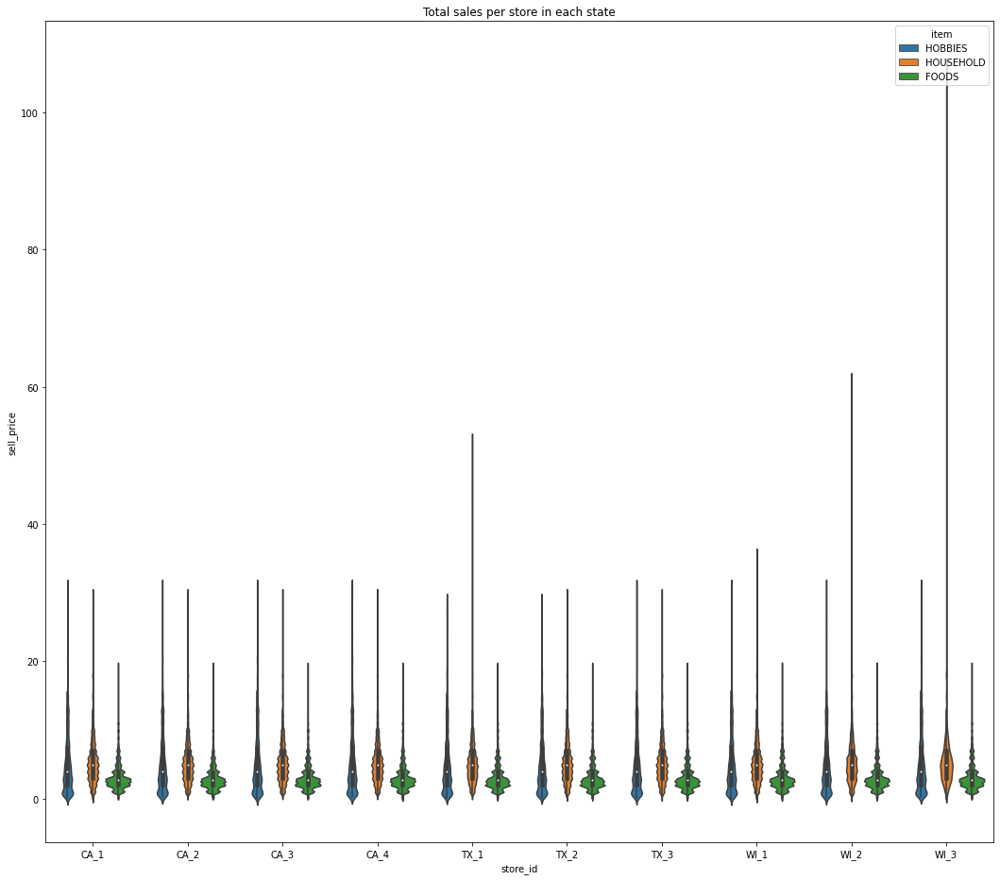

In [ ]:
fig, ax = plt.subplots(figsize=(18, 16))
# make grouped boxplot
sns.violinplot(y='sell_price', x='store_id', 
               data=df_prices, 
               hue='item').set_title('Total sales per store in each state')

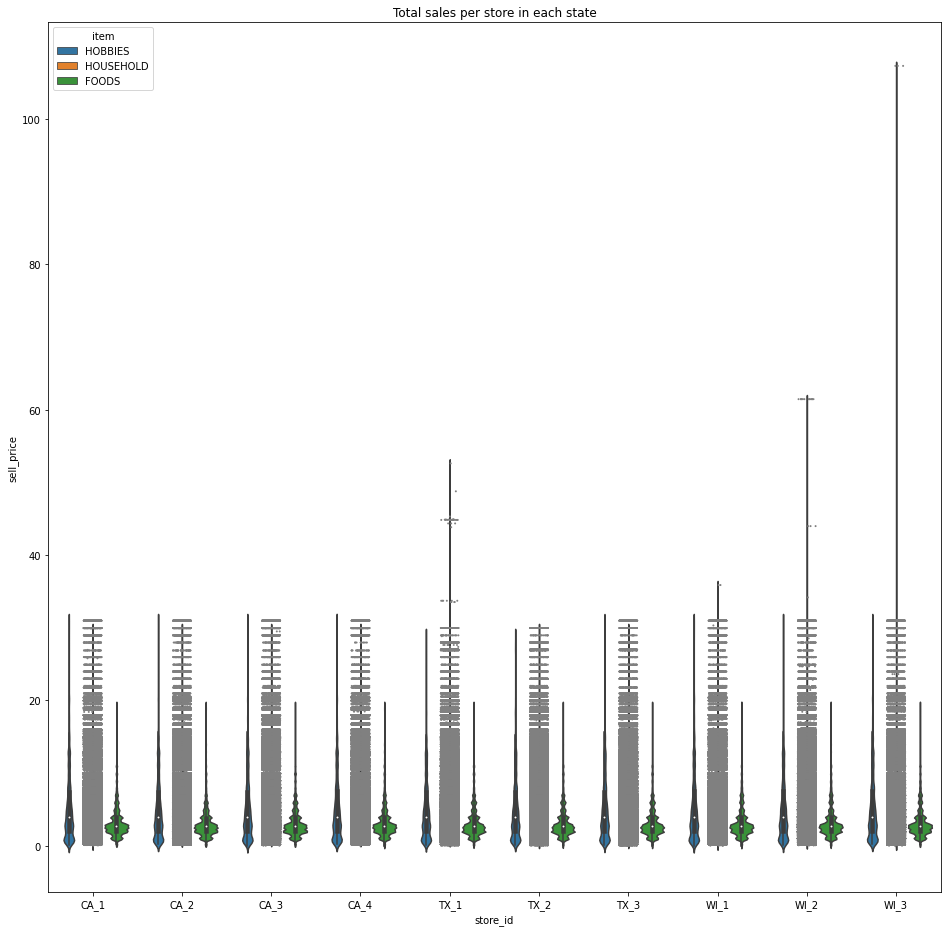

In [ ]:
fig, ax = plt.subplots(figsize=(16, 16))
sns.violinplot(x = "store_id", y = "sell_price", data = df_prices, hue = "item").set_title('Total sales per store in each state')
sns.stripplot(x = 'store_id', y = 'sell_price', data = df_prices, color = 'grey', size = 2, jitter = 1)

In [ ]:
fig = go.Figure()

fig.add_trace(go.Violin(x=df_prices['store_id'][ df_prices['item'] == 'HOBBIES' ],
                        y=df_prices['sell_price'][ df_prices['item'] == 'HOBBIES' ],
                        name='HB',
                        line_color='blue')
             )
fig.add_trace(go.Violin(x=df_prices['store_id'][ df_prices['item'] == 'HOUSEHOLD' ],
                        y=df_prices['sell_price'][ df_prices['item'] == 'HOUSEHOLD' ],
                        name='HH',
                        line_color='green')
             )
fig.add_trace(go.Violin(x=df_prices['store_id'][ df_prices['item'] == 'FOODS' ],
                        y=df_prices['sell_price'][ df_prices['item'] == 'FOODS' ],
                        name='F',
                        line_color='yellow')
             )


fig.update_traces(box_visible=True, meanline_visible=True)
fig.update_layout(violinmode='group')
fig.show()


In [ ]:

fig = go.Figure()

fig.add_trace(go.Violin(x=df_prices['store_id'][ df_prices['item'] == 'HOBBIES' ],
                        y=df_prices['sell_price'][ df_prices['item'] == 'HOBBIES' ],
                        name='H',
                        line_color='blue')
             )

fig.update_traces(box_visible=True, meanline_visible=True)
fig.update_layout(violinmode='group')
fig.show()

# Calender Heat Maps - Number of products sold on each day in each store, state and totally

# Time Series Plots

In [ ]:
def time_series_df_state(df, id_store):
  #df = pd.DataFrame(columns = ['Date', 'Hobbies','Household','foods'])
  df['Date'] = df_cal.loc[0:1940,'date']
  df['Date'] = pd.to_datetime(df['Date'])
  
  for count, day in enumerate(df_train_sales.columns[6:].to_list()):
    df['Hobbies'].iloc[count] = df_train_sales.loc[(df_train_sales['state_id'] == id_store) & (df_train_sales['cat_id'] == 'HOBBIES'), day].sum()
    df['Household'].iloc[count] = df_train_sales.loc[(df_train_sales['state_id'] == id_store) & (df_train_sales['cat_id'] == 'HOUSEHOLD'), day].sum()
    df['Foods'].iloc[count] = df_train_sales.loc[(df_train_sales['state_id'] == id_store) & (df_train_sales['cat_id'] == 'FOODS'), day].sum()
  
  df = df.set_index('Date', inplace=True, drop=True)

  

def time_series_df_store(df, id_store):
  #df = pd.DataFrame(columns = ['date', 'Hobbies','Household','foods'])
  df['Date'] = df_cal.loc[0:1940,'date']
  df['Date'] = pd.to_datetime(df['Date'])

  for count, day in enumerate(df_train_sales.columns[6:].to_list()):
    df['Hobbies'].iloc[count] = df_train_sales.loc[(df_train_sales['store_id'] == id_store) & (df_train_sales['cat_id'] == 'HOBBIES'), day].sum()
    df['Household'].iloc[count] = df_train_sales.loc[(df_train_sales['store_id'] == id_store) & (df_train_sales['cat_id'] == 'HOUSEHOLD'), day].sum()
    df['Foods'].iloc[count] = df_train_sales.loc[(df_train_sales['store_id'] == id_store) & (df_train_sales['cat_id'] == 'FOODS'), day].sum()
  
  df = df.set_index('Date', inplace=True, drop=True)
  

In [ ]:
df_time_series_ca = pd.DataFrame(columns = ['Date', 'Hobbies','Household','Foods'])
df_time_series_tx = pd.DataFrame(columns = ['Date', 'Hobbies','Household','Foods'])
df_time_series_wi = pd.DataFrame(columns = ['Date', 'Hobbies','Household','Foods'])

In [ ]:

df_time_series_ca_1 = pd.DataFrame(columns = ['Date', 'Hobbies','Household','Foods'])
df_time_series_ca_2 = pd.DataFrame(columns = ['Date', 'Hobbies','Household','Foods'])
df_time_series_ca_3 = pd.DataFrame(columns = ['Date', 'Hobbies','Household','Foods'])
df_time_series_ca_4 = pd.DataFrame(columns = ['Date', 'Hobbies','Household','Foods'])
df_time_series_tx_1 = pd.DataFrame(columns = ['Date', 'Hobbies','Household','Foods'])
df_time_series_tx_2 = pd.DataFrame(columns = ['Date', 'Hobbies','Household','Foods'])
df_time_series_tx_3 = pd.DataFrame(columns = ['Date', 'Hobbies','Household','Foods'])
df_time_series_wi_1 = pd.DataFrame(columns = ['Date', 'Hobbies','Household','Foods'])
df_time_series_wi_2 = pd.DataFrame(columns = ['Date', 'Hobbies','Household','Foods'])
df_time_series_wi_3 = pd.DataFrame(columns = ['Date', 'Hobbies','Household','Foods'])

In [ ]:
%%time
time_series_df_state(df_time_series_ca, 'CA')
time_series_df_state(df_time_series_tx, 'TX')
time_series_df_state(df_time_series_wi, 'WI')
#df_time_series_ca

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:671: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



CPU times: user 1min 15s, sys: 15.4 ms, total: 1min 15s
Wall time: 1min 15s


In [ ]:
df_time_series_tx

,Hobbies,Household,Foods
Date,,,
2011-01-29,879,1706,6853
2011-01-30,870,1730,7030
2011-01-31,526,1128,5124
2011-02-01,809,1102,5470
2011-02-02,501,809,4602
...,...,...,...
2016-05-18,1056,2723,6596
2016-05-19,830,2249,6083
2016-05-20,1132,3206,7965


In [ ]:
%%time
df_time_series = pd.DataFrame(columns = ['Date','weekday','month','year', 'Hobbies','Household','Foods'])
df_time_series['Date'] = df_cal.loc[0:1940,'date']
df_time_series['weekday'] = df_cal.loc[0:1940,'weekday']
df_time_series['month'] = df_cal.loc[0:1940,'month']
df_time_series['year'] = df_cal.loc[0:1940,'year']

df_time_series['Date'] = pd.to_datetime(df_time_series['Date'])
df_time_series.set_index('Date', inplace=True, drop=True)


df_time_series['Hobbies'] = df_time_series_ca['Hobbies'] + df_time_series_tx['Hobbies'] + df_time_series_wi['Hobbies']
df_time_series['Household'] = df_time_series_ca['Household'] + df_time_series_tx['Household'] + df_time_series_wi['Household']
df_time_series['Foods'] = df_time_series_ca['Foods'] + df_time_series_tx['Foods'] + df_time_series_wi['Foods']
df_time_series['CA'] = df_time_series_ca['Hobbies'] + df_time_series_ca['Household'] + df_time_series_ca['Foods']
df_time_series['TX'] = df_time_series_tx['Hobbies'] + df_time_series_tx['Household'] + df_time_series_tx['Foods']
df_time_series['WI'] = df_time_series_wi['Hobbies'] + df_time_series_wi['Household'] + df_time_series_wi['Foods']

df_time_series

CPU times: user 23.1 ms, sys: 12 µs, total: 23.1 ms
Wall time: 22.1 ms


In [ ]:
df_time_series

,weekday,month,year,Hobbies,Household,Foods,CA,TX,WI
Date,,,,,,,,,
2011-01-29,Saturday,1,2011,3764,5689,23178,14195,9438,8998
2011-01-30,Sunday,1,2011,3357,5634,22758,13805,9630,8314
2011-01-31,Monday,1,2011,2682,3927,17174,10108,6778,6897
2011-02-01,Tuesday,2,2011,2669,3865,18878,11047,7381,6984
2011-02-02,Wednesday,2,2011,1814,2729,14603,9925,5912,3309
...,...,...,...,...,...,...,...,...,...
2016-05-18,Wednesday,5,2016,3740,8566,24790,15678,10375,11043
2016-05-19,Thursday,5,2016,3475,8751,24737,16297,9162,11504
2016-05-20,Friday,5,2016,4143,10273,28136,17430,12303,12819


In [ ]:
%%time
time_series_df_store(df_time_series_ca_1, 'CA_1')
time_series_df_store(df_time_series_ca_2, 'CA_2')
time_series_df_store(df_time_series_ca_3, 'CA_3')
time_series_df_store(df_time_series_ca_4, 'CA_4')

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:671: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



CPU times: user 1min 38s, sys: 36.5 ms, total: 1min 38s
Wall time: 1min 38s


In [ ]:
%%time
time_series_df_store(df_time_series_tx_1, 'TX_1')
time_series_df_store(df_time_series_tx_2, 'TX_2')
time_series_df_store(df_time_series_tx_3, 'TX_3')

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:671: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



CPU times: user 1min 14s, sys: 13.7 ms, total: 1min 14s
Wall time: 1min 14s


In [ ]:
%%time
time_series_df_store(df_time_series_wi_1, 'WI_1')
time_series_df_store(df_time_series_wi_2, 'WI_2')
time_series_df_store(df_time_series_wi_3, 'WI_3')

/usr/local/lib/python3.6/dist-packages/pandas/core/indexing.py:671: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



CPU times: user 1min 17s, sys: 14.8 ms, total: 1min 17s
Wall time: 1min 17s


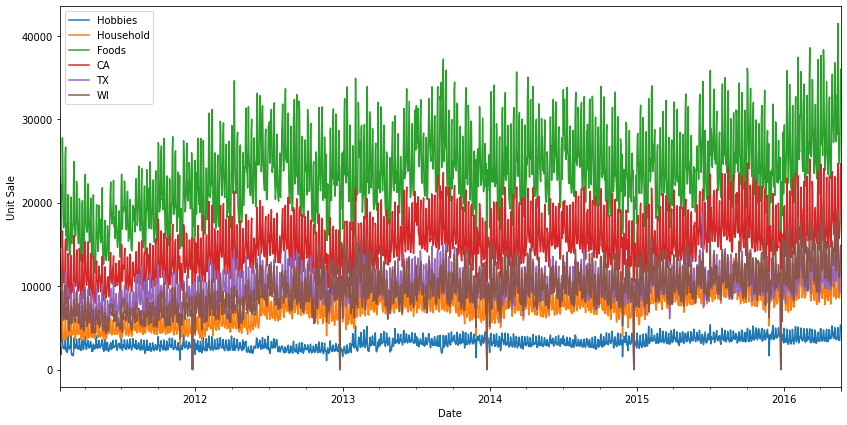

In [ ]:
ax = df_time_series.drop(['weekday', 'month','year'], axis=1).plot(figsize=(14,7))
ax.set_xlabel('Date')
ax.set_ylabel('Unit Sale')
plt.show()


In [ ]:
# Add columns with year, month, and weekday name
df_time_series['Year'] = df_time_series.index.year
df_time_series['Month'] = df_time_series.index.month
#df_time_series['Weekday Name'] = df_time_series.index.weekday_name
# Display a random sampling of 5 rows
df_time_series.sample(5, random_state=0)

,Hobbies,Household,Foods,CA,TX,WI,Year,Month
Date,,,,,,,,
2013-03-07,2160,6524,21086,11588,9355,8827,2013,3
2013-01-02,2145,7391,22648,13252,8387,10545,2013,1
2013-01-24,2852,5430,16685,10077,7494,7396,2013,1
2011-09-01,2624,5170,18505,10865,8827,6607,2011,9
2014-04-01,3100,8241,22367,14505,10208,8995,2014,4


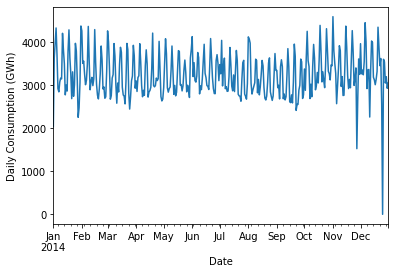

In [ ]:
ax = df_time_series.loc['2014', 'Hobbies'].plot()
ax.set_ylabel('Daily Consumption (GWh)');

In [ ]:
df_time_series

,weekday,month,year,Hobbies,Household,Foods,CA,TX,WI
Date,,,,,,,,,
2011-01-29,Saturday,1,2011,3764,5689,23178,14195,9438,8998
2011-01-30,Sunday,1,2011,3357,5634,22758,13805,9630,8314
2011-01-31,Monday,1,2011,2682,3927,17174,10108,6778,6897
2011-02-01,Tuesday,2,2011,2669,3865,18878,11047,7381,6984
2011-02-02,Wednesday,2,2011,1814,2729,14603,9925,5912,3309
...,...,...,...,...,...,...,...,...,...
2016-05-18,Wednesday,5,2016,3740,8566,24790,15678,10375,11043
2016-05-19,Thursday,5,2016,3475,8751,24737,16297,9162,11504
2016-05-20,Friday,5,2016,4143,10273,28136,17430,12303,12819


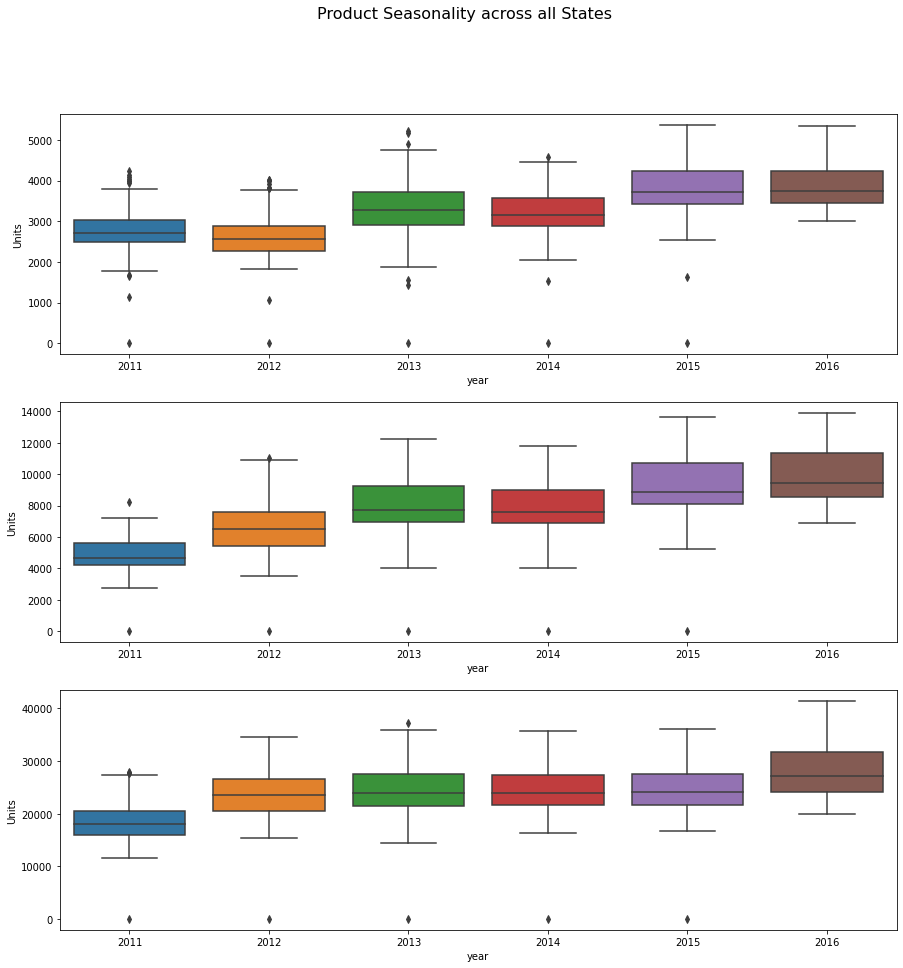

In [ ]:
fig, axes = plt.subplots(3,figsize=(15,15))
fig.suptitle('Product Seasonality across all States', fontsize=16)
#fig, axes = plt.subplots(3, 1, figsize=(11, 10), sharex=True)
for name, ax in zip(['Hobbies', 'Household', 'Foods'], axes):
  sns.boxplot(data=df_time_series, x='year', y=name, ax=ax)
  ax.set_ylabel('Units')

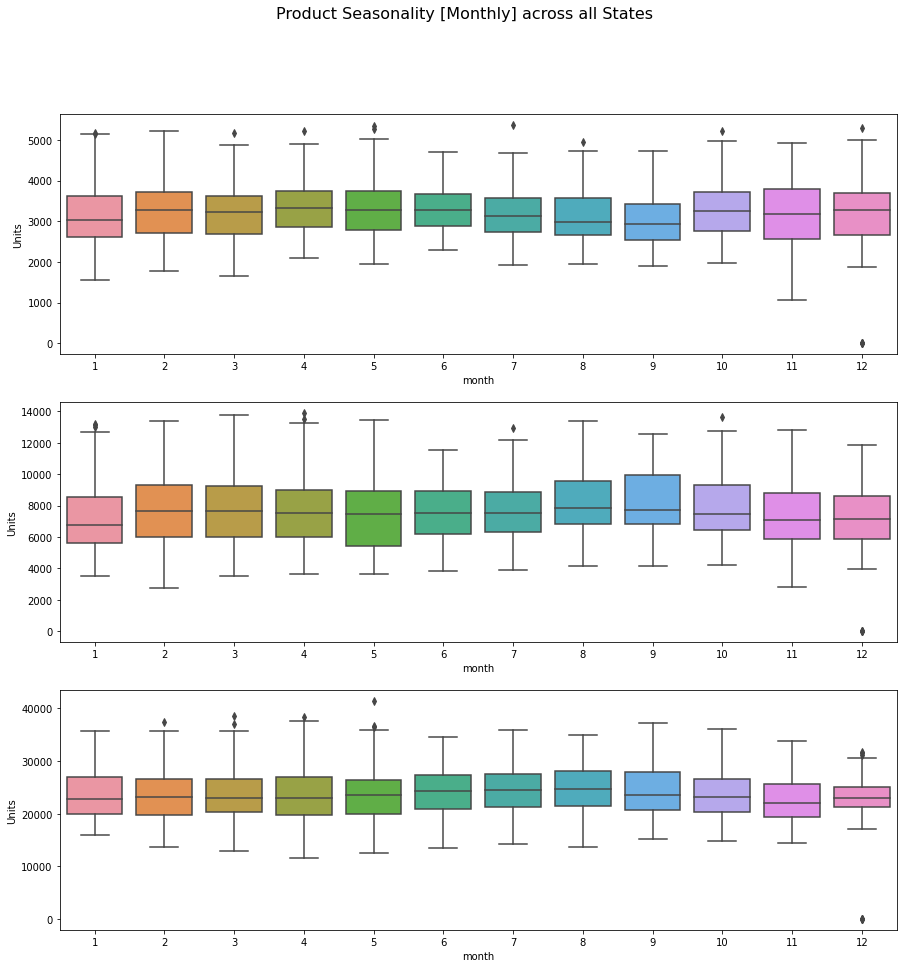

In [ ]:
fig, axes = plt.subplots(3,figsize=(15,15))
fig.suptitle('Product Seasonality [Monthly] across all States', fontsize=16)

for name, ax in zip(['Hobbies', 'Household', 'Foods'], axes):
  sns.boxplot(data=df_time_series, x='month', y=name, ax=ax)
  ax.set_ylabel('Units')


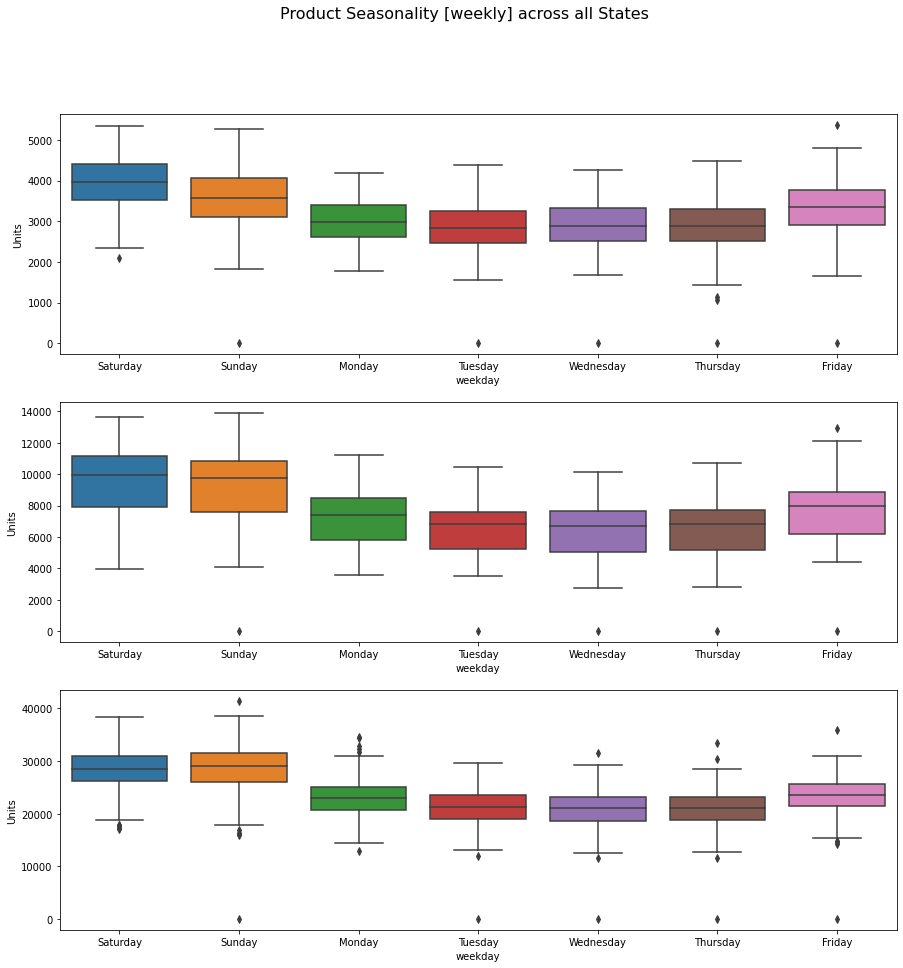

In [ ]:
fig, axes = plt.subplots(3,figsize=(15,15))
fig.suptitle('Product Seasonality [weekly] across all States', fontsize=16)

for name, ax in zip(['Hobbies', 'Household', 'Foods'], axes):
  sns.boxplot(data=df_time_series, x='weekday', y=name, ax=ax)
  ax.set_ylabel('Units')


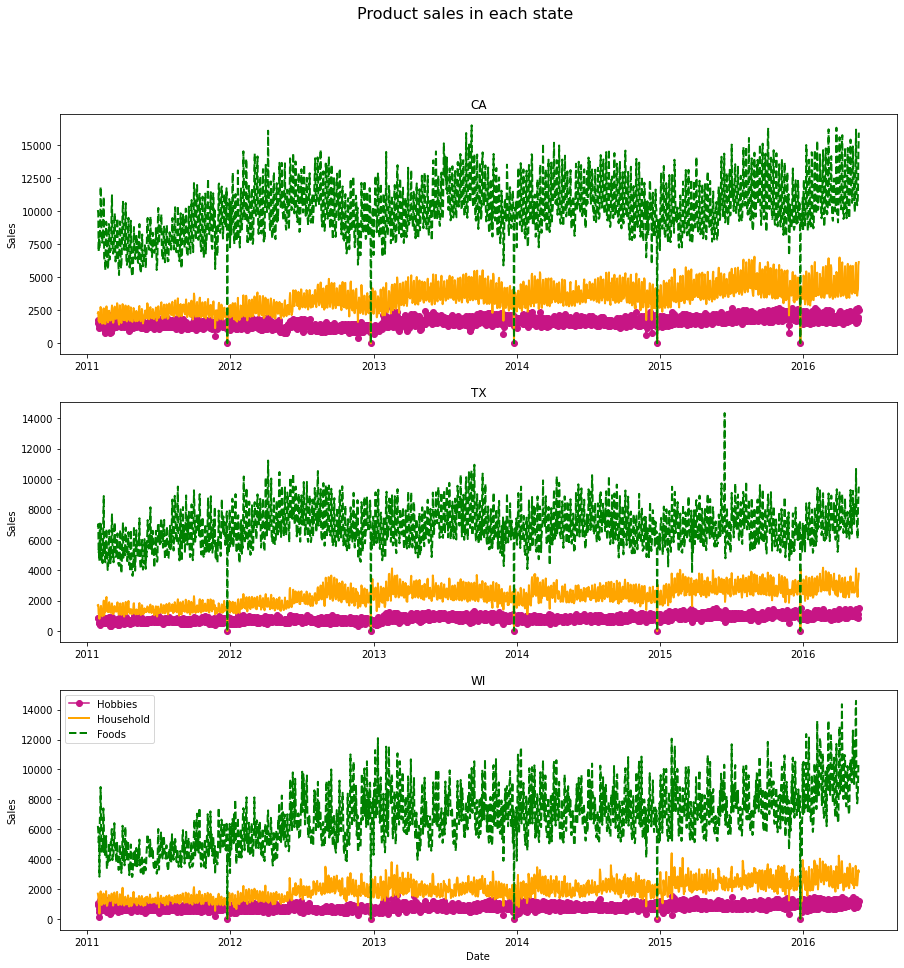

In [ ]:
#ax = df_time_series_ca.plot(colormap='Dark2', figsize=(14,7))

fig, axs = plt.subplots(3,figsize=(15,15))
fig.suptitle('Product sales in each state', fontsize=16)


import seaborn as sns
axs[0].plot( df_time_series_ca.index, 'Hobbies', data=df_time_series_ca, marker='o', color='mediumvioletred')
axs[0].plot( df_time_series_ca.index, 'Household', data=df_time_series_ca, marker='', color='orange', linewidth=2)
axs[0].plot( df_time_series_ca.index, 'Foods', data=df_time_series_ca, marker='', color='green', linewidth=2, linestyle='dashed')
axs[0].set_title('CA')
#axs[0].set_xlabel('Date')
axs[0].set_ylabel('Sales')


axs[1].plot( df_time_series_tx.index, 'Hobbies', data=df_time_series_tx, marker='o', color='mediumvioletred')
axs[1].plot( df_time_series_tx.index, 'Household', data=df_time_series_tx, marker='', color='orange', linewidth=2)
axs[1].plot( df_time_series_tx.index, 'Foods', data=df_time_series_tx, marker='', color='green', linewidth=2, linestyle='dashed')
axs[1].set_title('TX')
#axs[1].set_xlabel('Date')
axs[1].set_ylabel('Sales')


axs[2].plot( df_time_series_wi.index, 'Hobbies', data=df_time_series_wi, marker='o', color='mediumvioletred')
axs[2].plot( df_time_series_wi.index, 'Household', data=df_time_series_wi, marker='', color='orange', linewidth=2)
axs[2].plot( df_time_series_wi.index, 'Foods', data=df_time_series_wi, marker='', color='green', linewidth=2, linestyle='dashed')
axs[2].set_title('WI')
axs[2].set_xlabel('Date')
axs[2].set_ylabel('Sales')


plt.legend()
plt.show()


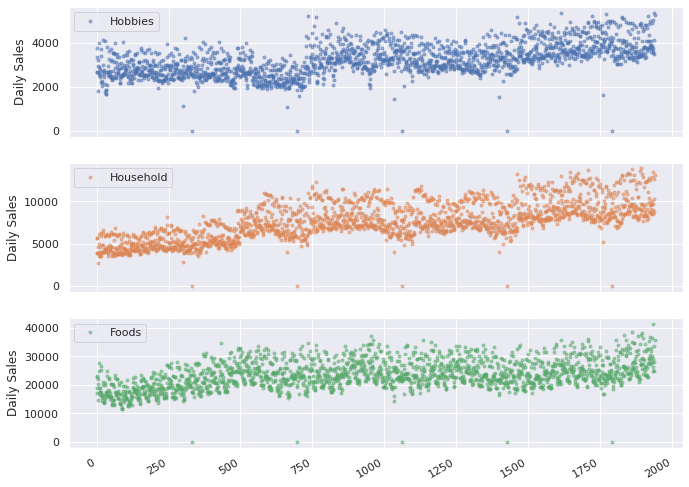

In [ ]:
                                      
import matplotlib.pyplot as plt
import seaborn as sns
# Use seaborn style defaults and set the default figure size
sns.set(rc={'figure.figsize':(11, 4)})


cols_plot = ['Hobbies', 'Household', 'Foods']
axes = df_time_series[cols_plot].plot(marker='.', alpha=0.5, linestyle='None', figsize=(11, 9), subplots=True)
for ax in axes:
    ax.set_ylabel('Daily Sales')

In [ ]:
from plotly.offline import download_plotlyjs,init_notebook_mode,plot
import plotly.graph_objs as go

trace1 = go.Scatter(
x=df_time_series.Date,
y=df_time_series.Hobbies,mode = 'markers',showlegend=True,name='Hobbies')

trace2 = go.Scatter(
x=df_time_series.Date,
y=df_time_series.Household, mode = 'markers',showlegend=True,name='Household')

trace3 = go.Scatter(
x=df_time_series.Date,
y=df_time_series.Foods, mode = 'markers',showlegend=True,name='Foods')

data = [trace1, trace2, trace3]

layout = go.Layout(title="<b> Unit Sales each day</b>",
xaxis=dict(
    title= '<b>Date</b>',
    zeroline=True,
    showline=True,
    mirror='ticks',
    gridcolor='#bdbdbd',
    gridwidth=2,
    zerolinecolor='#969696',
    zerolinewidth=4,
    linecolor='#636363',
    linewidth=6
),
yaxis=dict(
    title= '<b>Sales</b>',
    zeroline=True,
    showline=True,
    mirror='ticks',
    gridcolor='#bdbdbd',
    gridwidth=2,
    zerolinecolor='#969696',
    zerolinewidth=4,
    linecolor='#636363',
    linewidth=6
)
)
fig = go.Figure(data=data, layout=layout)
fig.show()

In [ ]:
from plotly.offline import download_plotlyjs,init_notebook_mode,plot
import plotly.graph_objs as go

trace1 = go.Scatter(
x=df_time_series.Date,
y=df_time_series.CA,mode = 'markers',showlegend=True,name='CA')

trace2 = go.Scatter(
x=df_time_series.Date,
y=df_time_series.TX, mode = 'markers',showlegend=True,name='TX')

trace3 = go.Scatter(
x=df_time_series.Date,
y=df_time_series.WI, mode = 'markers',showlegend=True,name='WI')

data = [trace1, trace2, trace3]

layout = go.Layout(title="<b> Unit Sales each day</b>",
xaxis=dict(
    title= '<b>Date</b>',
    zeroline=True,
    showline=True,
    mirror='ticks',
    gridcolor='#bdbdbd',
    gridwidth=2,
    zerolinecolor='#969696',
    zerolinewidth=4,
    linecolor='#636363',
    linewidth=6
),
yaxis=dict(
    title= '<b>Sales</b>',
    zeroline=True,
    showline=True,
    mirror='ticks',
    gridcolor='#bdbdbd',
    gridwidth=2,
    zerolinecolor='#969696',
    zerolinewidth=4,
    linecolor='#636363',
    linewidth=6
)
)
fig = go.Figure(data=data, layout=layout)
fig.update_xaxes(rangeslider_visible=True)
fig.show()

In [ ]:
from plotly.offline import download_plotlyjs,init_notebook_mode,plot
import plotly.graph_objs as go

trace1 = go.Scatter(
x=df_time_series_ca.Date,
y=df_time_series_ca.Hobbies,mode = 'markers',showlegend=True,name='Hobbies')

trace2 = go.Scatter(
x=df_time_series_ca.Date,
y=df_time_series_ca.Household, mode = 'markers',showlegend=True,name='Household')

trace3 = go.Scatter(
x=df_time_series_ca.Date,
y=df_time_series_ca.Foods, mode = 'markers',showlegend=True,name='Foods')

data = [trace1, trace2, trace3]

layout = go.Layout(title="<b> Unit Sales each day in California</b>",
xaxis=dict(
    title= '<b>Date</b>',
    zeroline=True,
    showline=True,
    mirror='ticks',
    gridcolor='#bdbdbd',
    gridwidth=2,
    zerolinecolor='#969696',
    zerolinewidth=4,
    linecolor='#636363',
    linewidth=6
),
yaxis=dict(
    title= '<b>Sales</b>',
    zeroline=True,
    showline=True,
    mirror='ticks',
    gridcolor='#bdbdbd',
    gridwidth=2,
    zerolinecolor='#969696',
    zerolinewidth=4,
    linecolor='#636363',
    linewidth=6
)
)
fig = go.Figure(data=data, layout=layout)
fig.show()

In [ ]:
df_time_series_ca

,Hobbies,Household,Foods
Date,,,
2011-01-29,1802,2292,10101
2011-01-30,1561,2382,9862
2011-01-31,1472,1692,6944
2011-02-01,1405,1778,7864
2011-02-02,1181,1566,7178
...,...,...,...
2016-05-18,1606,3607,10465
2016-05-19,1735,3912,10650
2016-05-20,1975,4101,11354


In [ ]:
#grouping by month

df = df_time_series[['CA','TX','WI']].groupby(pd.Grouper(freq='M')).sum()

import plotly.express as px


fig = go.Figure()
fig.add_trace(go.Scatter(x=df.index, y=df.CA,
                    mode='lines',
                    name='CA'))
fig.add_trace(go.Scatter(x=df.index, y=df.TX,
                    mode='lines+markers',
                    name='TX'))
fig.add_trace(go.Scatter(x=df.index, y=df.WI,
                    mode='markers', name='WI'))

fig.update_layout(title='Monthly Sales in each state',
                   xaxis_title='Month',
                   yaxis_title='Product Sale')

fig.show()

In [ ]:
fig = px.line(df_time_series_ca, x='Date', y='Hobbies')

# Use date string to set xaxis range
fig.update_layout(xaxis_range=['2014-07-01','2014-12-31'],
                  title_text="Manually Set Date Range")
fig.show()

In [ ]:
#fig = px.line(df_time_series_ca, x='Date', y='Hobbies', title='Time Series with Range Slider and Selectors')
fig = go.Figure([go.Scatter(x=df_time_series_ca['Date'], y=df_time_series_ca['Hobbies'])])
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

In [ ]:
df_time_series_ca['date'] = pd.to_datetime(df_time_series_ca['date'])

In [ ]:
df_time_series_ca.loc['2014-01-20':'2014-01-22']
#ax.set_ylabel('Daily Consumption (GWh)');

,Date,Hobbies,Household,Foods


In [ ]:
df_train_sales_ca.loc[df_train_sales_ca['d_1']]

df_train_sales_ca[df_train_sales_ca['d_1'].isin & (df_train_sales_ca['cat_id'] == 'HOBBIES') ]

In [ ]:
df_sales_train = df_train_sales.melt(id_vars=['id', 'item_id','dept_id','cat_id','store_id','state_id'], var_name='day',value_name='unit_sales',)
df_sales_train

,id,item_id,dept_id,cat_id,store_id,state_id,day,unit_sales
0,HOBBIES_1_001_CA_1_evaluation,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,d_1,0
1,HOBBIES_1_002_CA_1_evaluation,HOBBIES_1_002,HOBBIES_1,HOBBIES,CA_1,CA,d_1,0
2,HOBBIES_1_003_CA_1_evaluation,HOBBIES_1_003,HOBBIES_1,HOBBIES,CA_1,CA,d_1,0
3,HOBBIES_1_004_CA_1_evaluation,HOBBIES_1_004,HOBBIES_1,HOBBIES,CA_1,CA,d_1,0
4,HOBBIES_1_005_CA_1_evaluation,HOBBIES_1_005,HOBBIES_1,HOBBIES,CA_1,CA,d_1,0
...,...,...,...,...,...,...,...,...
59181085,FOODS_3_823_WI_3_evaluation,FOODS_3_823,FOODS_3,FOODS,WI_3,WI,d_1941,1
59181086,FOODS_3_824_WI_3_evaluation,FOODS_3_824,FOODS_3,FOODS,WI_3,WI,d_1941,0
59181087,FOODS_3_825_WI_3_evaluation,FOODS_3_825,FOODS_3,FOODS,WI_3,WI,d_1941,2
59181088,FOODS_3_826_WI_3_evaluation,FOODS_3_826,FOODS_3,FOODS,WI_3,WI,d_1941,0


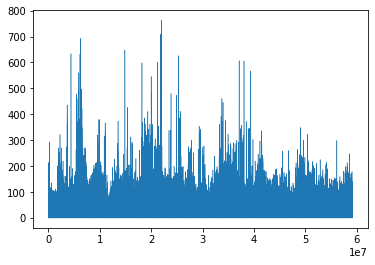

In [ ]:
df_sales_train['unit_sales'].plot(linewidth=0.5)

In [ ]:
df_train = pd.merge(df_sales_train, df_cal.rename(columns={'d':'day'}), how='left', on='day')
df_train

distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Restarting worker
distribu

In [ ]:
ax = df_train.loc['2011', 'unit_sales'].plot()
ax.set_ylabel('unit sales');

NameError: ignored

In [ ]:
df_train.to_csv('train.csv', index = True) 

/usr/local/lib/python3.6/dist-packages/modin/error_message.py:46: UserWarning:

`DataFrame.to_csv` defaulting to pandas implementation.

distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Restarting worker
distributed.nanny - WARNING - Worker exceeded 95% memory budget. Restarting
distributed.nanny - WARNING - Restarting wo

KeyboardInterrupt: ignored

In [ ]:
df_cal

In [ ]:
df_train_sales

,id,item_id,dept_id,cat_id,store_id,state_id,d_1,d_2,d_3,d_4,d_5,d_6,d_7,d_8,d_9,d_10,d_11,d_12,d_13,d_14,d_15,d_16,d_17,d_18,d_19,d_20,d_21,d_22,d_23,d_24,d_25,d_26,d_27,d_28,d_29,d_30,d_31,d_32,d_33,d_34,...,d_1902,d_1903,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913,d_1914,d_1915,d_1916,d_1917,d_1918,d_1919,d_1920,d_1921,d_1922,d_1923,d_1924,d_1925,d_1926,d_1927,d_1928,d_1929,d_1930,d_1931,d_1932,d_1933,d_1934,d_1935,d_1936,d_1937,d_1938,d_1939,d_1940,d_1941
0,HOBBIES_1_001_CA_1_evaluation,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,1,1,3,0,1,1,1,3,0,1,1,0,0,0,2,0,3,5,0,0,1,1,0,2,1,2,2,1,0,2,4,0,0,0,0,3,3,0,1
1,HOBBIES_1_002_CA_1_evaluation,HOBBIES_1_002,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,2,1,1,0,0,0,0,0
2,HOBBIES_1_003_CA_1_evaluation,HOBBIES_1_003,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,2,2,1,2,1,1,1,0,1,1,1,0,0,1,1,0,2,1,0,0,0,0,2,1,3,0,0,1,0,1,0,2,0,0,0,2,3,0,1
3,HOBBIES_1_004_CA_1_evaluation,HOBBIES_1_004,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,3,0,1,0,5,4,1,0,1,3,7,2,0,0,1,2,4,1,6,4,0,0,0,2,2,4,2,1,1,1,1,1,0,4,0,1,3,0,2,6
4,HOBBIES_1_005_CA_1_evaluation,HOBBIES_1_005,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,1,2,1,1,0,1,1,2,2,2,4,1,0,2,3,1,0,3,2,3,1,1,3,2,3,2,2,2,2,0,0,0,2,1,0,0,2,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30485,FOODS_3_823_WI_3_evaluation,FOODS_3_823,FOODS_3,FOODS,WI_3,WI,0,0,2,2,0,3,1,4,1,0,0,3,4,4,0,0,1,0,1,1,7,7,3,6,3,3,7,12,4,2,7,5,12,5,...,0,0,2,0,0,0,0,0,1,0,0,1,0,0,0,2,2,0,0,0,2,0,0,1,1,1,0,0,1,0,1,0,3,0,1,1,0,0,1,1
30486,FOODS_3_824_WI_3_evaluation,FOODS_3_824,FOODS_3,FOODS,WI_3,WI,0,0,0,0,0,5,0,1,1,3,1,1,0,4,2,0,1,2,1,1,0,0,0,0,3,1,1,1,2,0,1,0,1,1,...,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,1,0,0,0,0,1,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0
30487,FOODS_3_825_WI_3_evaluation,FOODS_3_825,FOODS_3,FOODS,WI_3,WI,0,6,0,2,2,4,1,8,5,2,7,5,3,5,20,8,10,3,3,4,7,2,3,5,6,3,4,1,2,5,1,2,2,2,...,0,0,2,1,0,2,0,1,0,0,1,0,0,0,1,1,0,2,1,1,0,0,1,0,0,1,0,3,3,1,0,0,1,2,0,1,0,1,0,2
30488,FOODS_3_826_WI_3_evaluation,FOODS_3_826,FOODS_3,FOODS,WI_3,WI,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,3,0,0,1,0,0,1,0,3,1,3,1,3,0,1,2,1,0,2,1,1,2,0,2,1,1,0,2,1,1,1,1,4,6,0,1,1,1,0


In [ ]:
df_train_sales.fillna(0)
df_train_sales_exp = df_train_sales
# select first six columns
df = df_train_sales_exp[df_train_sales_exp.columns[6:]]
sum1 = df.sum(axis=0)
sum1 = sum1.values.tolist()
df_cal_total.loc[:,'Total'] = pd.Series(sum1)
df_cal_total

,date,wm_yr_wk,weekday,wday,month,year,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI,Total,CA_1_Total,CA_2_Total,CA_3_Total,CA_4_Total,TX_1_Total,TX_2_Total,TX_3_Total,WI_1_Total,WI_2_Total,WI_3_Total
0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0,32631.0,4337.0,3494.0,4739.0,1625.0,2556.0,3852.0,3030.0,2704.0,2256.0,4038.0
1,2011-01-30,11101,Sunday,2,1,2011,d_2,NaN,NaN,NaN,NaN,0,0,0,31749.0,4155.0,3046.0,4827.0,1777.0,2687.0,3937.0,3006.0,2194.0,1922.0,4198.0
2,2011-01-31,11101,Monday,3,1,2011,d_3,NaN,NaN,NaN,NaN,0,0,0,23783.0,2816.0,2121.0,3785.0,1386.0,1822.0,2731.0,2225.0,1562.0,2018.0,3317.0
3,2011-02-01,11101,Tuesday,4,2,2011,d_4,NaN,NaN,NaN,NaN,1,1,0,25412.0,3051.0,2324.0,4232.0,1440.0,2258.0,2954.0,2169.0,1251.0,2522.0,3211.0
4,2011-02-02,11101,Wednesday,5,2,2011,d_5,NaN,NaN,NaN,NaN,1,0,1,19146.0,2630.0,1942.0,3817.0,1536.0,1694.0,2492.0,1726.0,2.0,1175.0,2132.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1964,2016-06-15,11620,Wednesday,5,6,2016,d_1965,NaN,NaN,NaN,NaN,0,1,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1965,2016-06-16,11620,Thursday,6,6,2016,d_1966,NaN,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1966,2016-06-17,11620,Friday,7,6,2016,d_1967,NaN,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1967,2016-06-18,11621,Saturday,1,6,2016,d_1968,NaN,NaN,NaN,NaN,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
store_id = ['CA_1', 'CA_2', 'CA_3', 'CA_4', 'TX_1', 'TX_2', 'TX_3', 'WI_1', 'WI_2', 'WI_3']
for i in store_id:
	df = df_train_sales.loc[(df_train_sales['store_id'] == i)]
	df = df[df.columns[4:]]
	total = df.sum(axis=0)
	total = total[2:].values.tolist()
	df_cal_total.loc[:,i+'_Total'] = pd.Series(total)
 

In [ ]:
df_cal_total.iloc[1940,:]

date            2016-05-22
wm_yr_wk             11617
weekday             Sunday
wday                     2
month                    5
year                  2016
d                   d_1941
event_name_1           NaN
event_type_1           NaN
event_name_2           NaN
event_type_2           NaN
snap_CA                  0
snap_TX                  0
snap_WI                  0
Total                54338
CA_1_Total            6289
CA_2_Total            6614
CA_3_Total            8144
CA_4_Total            3597
TX_1_Total            4624
TX_2_Total            5217
TX_3_Total            4974
WI_1_Total            5054
WI_2_Total            5068
WI_3_Total            4757
Name: 1940, dtype: object

In [ ]:
all_days = pd.date_range('1/29/2011', periods=1941, freq='D')
series1 = df_cal_total['Total'].iloc[0:1941].values.tolist()
total_sold_product = pd.Series(series1, index=all_days)
total_sold_product 

2011-01-29    32631.0
2011-01-30    31749.0
2011-01-31    23783.0
2011-02-01    25412.0
2011-02-02    19146.0
               ...   
2016-05-18    37096.0
2016-05-19    36963.0
2016-05-20    42552.0
2016-05-21    51518.0
2016-05-22    54338.0
Freq: D, Length: 1941, dtype: float64

(<Figure size 5040x720 with 6 Axes>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f6f076ae6d8>,
       dtype=object))

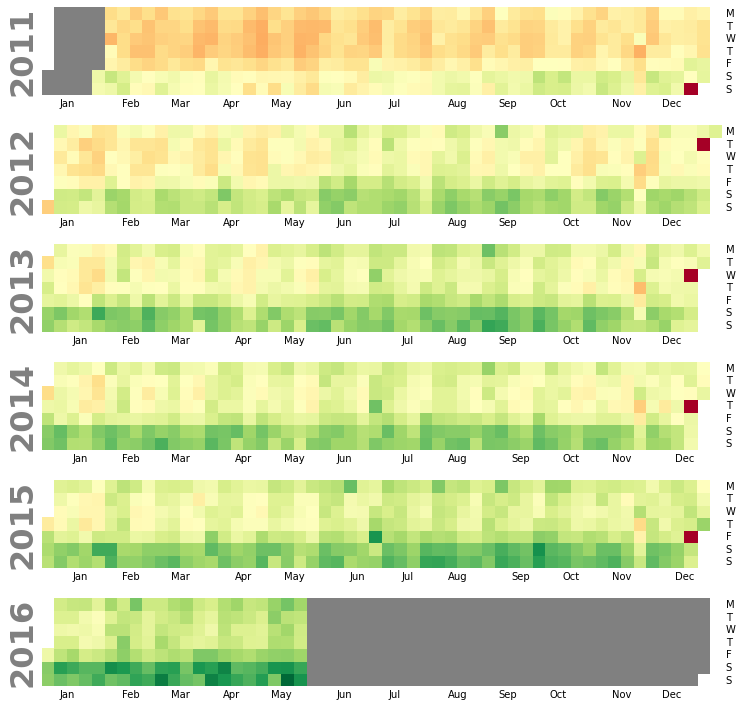

In [ ]:
calmap.calendarplot(total_sold_product, daylabels='MTWTFSS',
                    cmap='RdYlGn',
                    fillcolor='grey', linewidth=0,
                    fig_kws=dict(figsize=(70, 10)))

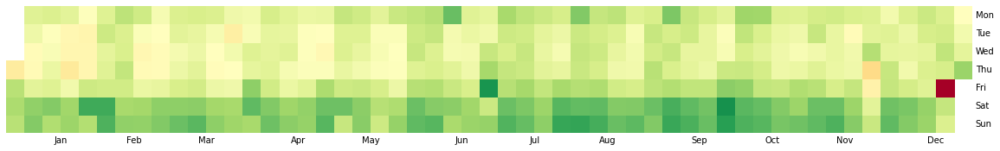

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(20, 16))
calmap.yearplot(total_sold_product, year = 2015, cmap='RdYlGn', fillcolor='grey',
                linewidth=0)

In [ ]:
all_days = pd.date_range('1/29/2011', periods=1941, freq='D')
series1 = df_cal_total['CA_1_Total'].iloc[0:1941].values.tolist()
total_sold_product_CA_1 = pd.Series(series1, index=all_days)
#total_sold_product_CA_1 

(<Figure size 5040x720 with 6 Axes>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f6f0c59e4a8>,
       dtype=object))

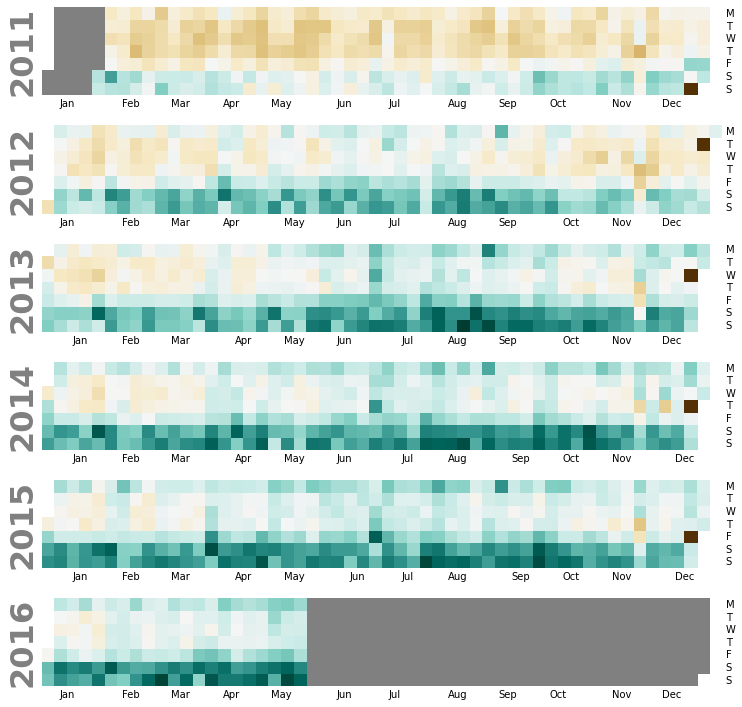

In [ ]:
calmap.calendarplot(total_sold_product_CA_1, daylabels='MTWTFSS',
                    cmap='BrBG',
                    fillcolor='grey', linewidth=0,
                    fig_kws=dict(figsize=(70, 10)))

# Modelling

1. train our model to perform predictions on forecasting daily sales for the next 28 days.
2. we introduce lagging and rolling variables to capture seasonality trends.
3. We train test split the data such that where we forecast for 28 days in the future with 5 years of data, the last 28 days are kept as validation.

In [ ]:
df_cal

,date,wm_yr_wk,weekday,wday,month,year,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI
0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
1,2011-01-30,11101,Sunday,2,1,2011,d_2,NaN,NaN,NaN,NaN,0,0,0
2,2011-01-31,11101,Monday,3,1,2011,d_3,NaN,NaN,NaN,NaN,0,0,0
3,2011-02-01,11101,Tuesday,4,2,2011,d_4,NaN,NaN,NaN,NaN,1,1,0
4,2011-02-02,11101,Wednesday,5,2,2011,d_5,NaN,NaN,NaN,NaN,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1964,2016-06-15,11620,Wednesday,5,6,2016,d_1965,NaN,NaN,NaN,NaN,0,1,1
1965,2016-06-16,11620,Thursday,6,6,2016,d_1966,NaN,NaN,NaN,NaN,0,0,0
1966,2016-06-17,11620,Friday,7,6,2016,d_1967,NaN,NaN,NaN,NaN,0,0,0
1967,2016-06-18,11621,Saturday,1,6,2016,d_1968,NaN,NaN,NaN,NaN,0,0,0


In [ ]:
df_train_sales_valid_ca = df_train_sales_valid[df_train_sales_valid['state_id']=='CA']
df_train_sales_valid_tx = df_train_sales_valid[df_train_sales_valid['state_id']=='TX']
df_train_sales_valid_wi = df_train_sales_valid[df_train_sales_valid['state_id']=='WI']
df_train_sales_eval_ca = df_train_sales_eval[df_train_sales_valid['state_id']=='CA']
df_train_sales_eval_tx = df_train_sales_eval[df_train_sales_valid['state_id']=='TX']
df_train_sales_eval_wi = df_train_sales_eval[df_train_sales_valid['state_id']=='WI']

In [ ]:
df_train_sales_valid

,id,item_id,dept_id,cat_id,store_id,state_id,d_1,d_2,d_3,d_4,d_5,d_6,d_7,d_8,d_9,d_10,d_11,d_12,d_13,d_14,d_15,d_16,d_17,d_18,d_19,d_20,d_21,d_22,d_23,d_24,d_25,d_26,d_27,d_28,d_29,d_30,d_31,d_32,d_33,d_34,d_35,d_36,d_37,d_38,d_39,d_40,d_41,d_42,d_43,d_44,d_45,d_46,d_47,d_48,d_49,d_50,d_51,d_52,d_53,d_54,d_55,d_56,d_57,d_58,d_59,d_60,d_61,d_62,d_63,d_64,d_65,d_66,d_67,d_68,d_69,d_70,d_71,d_72,d_73,d_74,d_75,d_76,d_77,d_78,d_79,d_80,d_81,d_82,d_83,d_84,d_85,d_86,d_87,d_88,d_89,d_90,d_91,d_92,d_93,d_94,d_95,d_96,d_97,d_98,d_99,d_100,d_101,d_102,d_103,d_104,d_105,d_106,d_107,d_108,d_109,d_110,d_111,d_112,d_113,d_114,d_115,d_116,d_117,d_118,d_119,d_120,d_121,d_122,d_123,d_124,d_125,d_126,d_127,d_128,d_129,d_130,d_131,d_132,d_133,d_134,d_135,d_136,d_137,d_138,d_139,d_140,d_141,d_142,d_143,d_144,d_145,d_146,d_147,d_148,d_149,d_150,d_151,d_152,d_153,d_154,d_155,d_156,d_157,d_158,d_159,d_160,d_161,d_162,d_163,d_164,d_165,d_166,d_167,d_168,d_169,d_170,d_171,d_172,d_173,d_174,d_175,d_176,d_177,d_178,d_179,d_180,d_181,d_182,d_183,d_184,d_185,d_186,d_187,d_188,d_189,d_190,d_191,d_192,d_193,d_194,d_195,d_196,d_197,d_198,d_199,d_200,d_201,d_202,d_203,d_204,d_205,d_206,d_207,d_208,d_209,d_210,d_211,d_212,d_213,d_214,d_215,d_216,d_217,d_218,d_219,d_220,d_221,d_222,d_223,d_224,d_225,d_226,d_227,d_228,d_229,d_230,d_231,d_232,d_233,d_234,d_235,d_236,d_237,d_238,d_239,d_240,d_241,d_242,d_243,d_244,...,d_1664,d_1665,d_1666,d_1667,d_1668,d_1669,d_1670,d_1671,d_1672,d_1673,d_1674,d_1675,d_1676,d_1677,d_1678,d_1679,d_1680,d_1681,d_1682,d_1683,d_1684,d_1685,d_1686,d_1687,d_1688,d_1689,d_1690,d_1691,d_1692,d_1693,d_1694,d_1695,d_1696,d_1697,d_1698,d_1699,d_1700,d_1701,d_1702,d_1703,d_1704,d_1705,d_1706,d_1707,d_1708,d_1709,d_1710,d_1711,d_1712,d_1713,d_1714,d_1715,d_1716,d_1717,d_1718,d_1719,d_1720,d_1721,d_1722,d_1723,d_1724,d_1725,d_1726,d_1727,d_1728,d_1729,d_1730,d_1731,d_1732,d_1733,d_1734,d_1735,d_1736,d_1737,d_1738,d_1739,d_1740,d_1741,d_1742,d_1743,d_1744,d_1745,d_1746,d_1747,d_1748,d_1749,d_1750,d_1751,d_1752,d_1753,d_1754,d_1755,d_1756,d_1757,d_1758,d_1759,d_1760,d_1761,d_1762,d_1763,d_1764,d_1765,d_1766,d_1767,d_1768,d_1769,d_1770,d_1771,d_1772,d_1773,d_1774,d_1775,d_1776,d_1777,d_1778,d_1779,d_1780,d_1781,d_1782,d_1783,d_1784,d_1785,d_1786,d_1787,d_1788,d_1789,d_1790,d_1791,d_1792,d_1793,d_1794,d_1795,d_1796,d_1797,d_1798,d_1799,d_1800,d_1801,d_1802,d_1803,d_1804,d_1805,d_1806,d_1807,d_1808,d_1809,d_1810,d_1811,d_1812,d_1813,d_1814,d_1815,d_1816,d_1817,d_1818,d_1819,d_1820,d_1821,d_1822,d_1823,d_1824,d_1825,d_1826,d_1827,d_1828,d_1829,d_1830,d_1831,d_1832,d_1833,d_1834,d_1835,d_1836,d_1837,d_1838,d_1839,d_1840,d_1841,d_1842,d_1843,d_1844,d_1845,d_1846,d_1847,d_1848,d_1849,d_1850,d_1851,d_1852,d_1853,d_1854,d_1855,d_1856,d_1857,d_1858,d_1859,d_1860,d_1861,d_1862,d_1863,d_1864,d_1865,d_1866,d_1867,d_1868,d_1869,d_1870,d_1871,d_1872,d_1873,d_1874,d_1875,d_1876,d_1877,d_1878,d_1879,d_1880,d_1881,d_1882,d_1883,d_1884,d_1885,d_1886,d_1887,d_1888,d_1889,d_1890,d_1891,d_1892,d_1893,d_1894,d_1895,d_1896,d_1897,d_1898,d_1899,d_1900,d_1901,d_1902,d_1903,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913
0,HOBBIES_1_001_CA_1_validation,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,1,0,0,2,0,2,2,0,0,0,1,1,0,2,0,1,1,2,0,1,0,0,0,2,1,0,1,1,2,0,0,0,0,0,0,0,1,0,1,0,1,0,3,1,1,0,1,1,2,0,0,0,0,1,1,0,0,0,0,3,0,1,0,0,0,0,1,1,1,0,1,0,2,0,0,0,0,2,0,0,0,0,1,1,2,0,0,0,0,2,0,0,1,1,1,1,0,0,0,0,0,1,2,2,0,1,0,0,0,0,1,2,1,0,0,0,0,0,1,0,3,0,1,2,1,0,3,0,0,0,1,0,2,2,1,0,0,1,2,0,1

In [ ]:
df_train_sales_valid_wi_1 = df_train_sales_valid[df_train_sales_valid['store_id']=='WI_1']

In [ ]:
df_train_sales_eval_wi_1 = df_train_sales_eval[df_train_sales_eval['store_id']=='WI_1']
df_train_sales_eval_wi_1

,id,item_id,dept_id,cat_id,store_id,state_id,d_1,d_2,d_3,d_4,d_5,d_6,d_7,d_8,d_9,d_10,d_11,d_12,d_13,d_14,d_15,d_16,d_17,d_18,d_19,d_20,d_21,d_22,d_23,d_24,d_25,d_26,d_27,d_28,d_29,d_30,d_31,d_32,d_33,d_34,d_35,d_36,d_37,d_38,d_39,d_40,d_41,d_42,d_43,d_44,d_45,d_46,d_47,d_48,d_49,d_50,d_51,d_52,d_53,d_54,d_55,d_56,d_57,d_58,d_59,d_60,d_61,d_62,d_63,d_64,d_65,d_66,d_67,d_68,d_69,d_70,d_71,d_72,d_73,d_74,d_75,d_76,d_77,d_78,d_79,d_80,d_81,d_82,d_83,d_84,d_85,d_86,d_87,d_88,d_89,d_90,d_91,d_92,d_93,d_94,d_95,d_96,d_97,d_98,d_99,d_100,d_101,d_102,d_103,d_104,d_105,d_106,d_107,d_108,d_109,d_110,d_111,d_112,d_113,d_114,d_115,d_116,d_117,d_118,d_119,d_120,d_121,d_122,d_123,d_124,d_125,d_126,d_127,d_128,d_129,d_130,d_131,d_132,d_133,d_134,d_135,d_136,d_137,d_138,d_139,d_140,d_141,d_142,d_143,d_144,d_145,d_146,d_147,d_148,d_149,d_150,d_151,d_152,d_153,d_154,d_155,d_156,d_157,d_158,d_159,d_160,d_161,d_162,d_163,d_164,d_165,d_166,d_167,d_168,d_169,d_170,d_171,d_172,d_173,d_174,d_175,d_176,d_177,d_178,d_179,d_180,d_181,d_182,d_183,d_184,d_185,d_186,d_187,d_188,d_189,d_190,d_191,d_192,d_193,d_194,d_195,d_196,d_197,d_198,d_199,d_200,d_201,d_202,d_203,d_204,d_205,d_206,d_207,d_208,d_209,d_210,d_211,d_212,d_213,d_214,d_215,d_216,d_217,d_218,d_219,d_220,d_221,d_222,d_223,d_224,d_225,d_226,d_227,d_228,d_229,d_230,d_231,d_232,d_233,d_234,d_235,d_236,d_237,d_238,d_239,d_240,d_241,d_242,d_243,d_244,...,d_1692,d_1693,d_1694,d_1695,d_1696,d_1697,d_1698,d_1699,d_1700,d_1701,d_1702,d_1703,d_1704,d_1705,d_1706,d_1707,d_1708,d_1709,d_1710,d_1711,d_1712,d_1713,d_1714,d_1715,d_1716,d_1717,d_1718,d_1719,d_1720,d_1721,d_1722,d_1723,d_1724,d_1725,d_1726,d_1727,d_1728,d_1729,d_1730,d_1731,d_1732,d_1733,d_1734,d_1735,d_1736,d_1737,d_1738,d_1739,d_1740,d_1741,d_1742,d_1743,d_1744,d_1745,d_1746,d_1747,d_1748,d_1749,d_1750,d_1751,d_1752,d_1753,d_1754,d_1755,d_1756,d_1757,d_1758,d_1759,d_1760,d_1761,d_1762,d_1763,d_1764,d_1765,d_1766,d_1767,d_1768,d_1769,d_1770,d_1771,d_1772,d_1773,d_1774,d_1775,d_1776,d_1777,d_1778,d_1779,d_1780,d_1781,d_1782,d_1783,d_1784,d_1785,d_1786,d_1787,d_1788,d_1789,d_1790,d_1791,d_1792,d_1793,d_1794,d_1795,d_1796,d_1797,d_1798,d_1799,d_1800,d_1801,d_1802,d_1803,d_1804,d_1805,d_1806,d_1807,d_1808,d_1809,d_1810,d_1811,d_1812,d_1813,d_1814,d_1815,d_1816,d_1817,d_1818,d_1819,d_1820,d_1821,d_1822,d_1823,d_1824,d_1825,d_1826,d_1827,d_1828,d_1829,d_1830,d_1831,d_1832,d_1833,d_1834,d_1835,d_1836,d_1837,d_1838,d_1839,d_1840,d_1841,d_1842,d_1843,d_1844,d_1845,d_1846,d_1847,d_1848,d_1849,d_1850,d_1851,d_1852,d_1853,d_1854,d_1855,d_1856,d_1857,d_1858,d_1859,d_1860,d_1861,d_1862,d_1863,d_1864,d_1865,d_1866,d_1867,d_1868,d_1869,d_1870,d_1871,d_1872,d_1873,d_1874,d_1875,d_1876,d_1877,d_1878,d_1879,d_1880,d_1881,d_1882,d_1883,d_1884,d_1885,d_1886,d_1887,d_1888,d_1889,d_1890,d_1891,d_1892,d_1893,d_1894,d_1895,d_1896,d_1897,d_1898,d_1899,d_1900,d_1901,d_1902,d_1903,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913,d_1914,d_1915,d_1916,d_1917,d_1918,d_1919,d_1920,d_1921,d_1922,d_1923,d_1924,d_1925,d_1926,d_1927,d_1928,d_1929,d_1930,d_1931,d_1932,d_1933,d_1934,d_1935,d_1936,d_1937,d_1938,d_1939,d_1940,d_1941
21343,HOBBIES_1_001_WI_1_evaluation,HOBBIES_1_001,HOBBIES_1,HOBBIES,WI_1,WI,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,1,1,0,1,0,0,1,1,0,0,1,0,0,0,0,0,0,0,0,2,1,2,0,0,1,0,0,2,1,0,0,0,0,1,0,2,0,0,0,1,0,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0,1,1,0,0,1,2,0,2,3,0,0,0,3,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,2,2,1,2,0,0,1,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,2,0,1,0,1,0,0,1,0,0,2,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,1

In [ ]:
def reduce_mem_usage(df, verbose=True):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = df.memory_usage().sum() / 1024**2    
    for col in df.columns:
        col_type = df[col].dtypes
        if col_type in numerics:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)    
    end_mem = df.memory_usage().sum() / 1024**2
    if verbose: print('Mem. usage decreased to {:5.2f} Mb ({:.1f}% reduction)'.format(end_mem, 100 * (start_mem - end_mem) / start_mem))
    return df

In [ ]:
df_train_sales_valid_wi_1

,id,item_id,dept_id,cat_id,store_id,state_id,d_1,d_2,d_3,d_4,d_5,d_6,d_7,d_8,d_9,d_10,d_11,d_12,d_13,d_14,d_15,d_16,d_17,d_18,d_19,d_20,d_21,d_22,d_23,d_24,d_25,d_26,d_27,d_28,d_29,d_30,d_31,d_32,d_33,d_34,d_35,d_36,d_37,d_38,d_39,d_40,d_41,d_42,d_43,d_44,d_45,d_46,d_47,d_48,d_49,d_50,d_51,d_52,d_53,d_54,d_55,d_56,d_57,d_58,d_59,d_60,d_61,d_62,d_63,d_64,d_65,d_66,d_67,d_68,d_69,d_70,d_71,d_72,d_73,d_74,d_75,d_76,d_77,d_78,d_79,d_80,d_81,d_82,d_83,d_84,d_85,d_86,d_87,d_88,d_89,d_90,d_91,d_92,d_93,d_94,d_95,d_96,d_97,d_98,d_99,d_100,d_101,d_102,d_103,d_104,d_105,d_106,d_107,d_108,d_109,d_110,d_111,d_112,d_113,d_114,d_115,d_116,d_117,d_118,d_119,d_120,d_121,d_122,d_123,d_124,d_125,d_126,d_127,d_128,d_129,d_130,d_131,d_132,d_133,d_134,d_135,d_136,d_137,d_138,d_139,d_140,d_141,d_142,d_143,d_144,d_145,d_146,d_147,d_148,d_149,d_150,d_151,d_152,d_153,d_154,d_155,d_156,d_157,d_158,d_159,d_160,d_161,d_162,d_163,d_164,d_165,d_166,d_167,d_168,d_169,d_170,d_171,d_172,d_173,d_174,d_175,d_176,d_177,d_178,d_179,d_180,d_181,d_182,d_183,d_184,d_185,d_186,d_187,d_188,d_189,d_190,d_191,d_192,d_193,d_194,d_195,d_196,d_197,d_198,d_199,d_200,d_201,d_202,d_203,d_204,d_205,d_206,d_207,d_208,d_209,d_210,d_211,d_212,d_213,d_214,d_215,d_216,d_217,d_218,d_219,d_220,d_221,d_222,d_223,d_224,d_225,d_226,d_227,d_228,d_229,d_230,d_231,d_232,d_233,d_234,d_235,d_236,d_237,d_238,d_239,d_240,d_241,d_242,d_243,d_244,...,d_1664,d_1665,d_1666,d_1667,d_1668,d_1669,d_1670,d_1671,d_1672,d_1673,d_1674,d_1675,d_1676,d_1677,d_1678,d_1679,d_1680,d_1681,d_1682,d_1683,d_1684,d_1685,d_1686,d_1687,d_1688,d_1689,d_1690,d_1691,d_1692,d_1693,d_1694,d_1695,d_1696,d_1697,d_1698,d_1699,d_1700,d_1701,d_1702,d_1703,d_1704,d_1705,d_1706,d_1707,d_1708,d_1709,d_1710,d_1711,d_1712,d_1713,d_1714,d_1715,d_1716,d_1717,d_1718,d_1719,d_1720,d_1721,d_1722,d_1723,d_1724,d_1725,d_1726,d_1727,d_1728,d_1729,d_1730,d_1731,d_1732,d_1733,d_1734,d_1735,d_1736,d_1737,d_1738,d_1739,d_1740,d_1741,d_1742,d_1743,d_1744,d_1745,d_1746,d_1747,d_1748,d_1749,d_1750,d_1751,d_1752,d_1753,d_1754,d_1755,d_1756,d_1757,d_1758,d_1759,d_1760,d_1761,d_1762,d_1763,d_1764,d_1765,d_1766,d_1767,d_1768,d_1769,d_1770,d_1771,d_1772,d_1773,d_1774,d_1775,d_1776,d_1777,d_1778,d_1779,d_1780,d_1781,d_1782,d_1783,d_1784,d_1785,d_1786,d_1787,d_1788,d_1789,d_1790,d_1791,d_1792,d_1793,d_1794,d_1795,d_1796,d_1797,d_1798,d_1799,d_1800,d_1801,d_1802,d_1803,d_1804,d_1805,d_1806,d_1807,d_1808,d_1809,d_1810,d_1811,d_1812,d_1813,d_1814,d_1815,d_1816,d_1817,d_1818,d_1819,d_1820,d_1821,d_1822,d_1823,d_1824,d_1825,d_1826,d_1827,d_1828,d_1829,d_1830,d_1831,d_1832,d_1833,d_1834,d_1835,d_1836,d_1837,d_1838,d_1839,d_1840,d_1841,d_1842,d_1843,d_1844,d_1845,d_1846,d_1847,d_1848,d_1849,d_1850,d_1851,d_1852,d_1853,d_1854,d_1855,d_1856,d_1857,d_1858,d_1859,d_1860,d_1861,d_1862,d_1863,d_1864,d_1865,d_1866,d_1867,d_1868,d_1869,d_1870,d_1871,d_1872,d_1873,d_1874,d_1875,d_1876,d_1877,d_1878,d_1879,d_1880,d_1881,d_1882,d_1883,d_1884,d_1885,d_1886,d_1887,d_1888,d_1889,d_1890,d_1891,d_1892,d_1893,d_1894,d_1895,d_1896,d_1897,d_1898,d_1899,d_1900,d_1901,d_1902,d_1903,d_1904,d_1905,d_1906,d_1907,d_1908,d_1909,d_1910,d_1911,d_1912,d_1913
21343,HOBBIES_1_001_WI_1_validation,HOBBIES_1_001,HOBBIES_1,HOBBIES,WI_1,WI,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,2,0,0,0,0,0,0,0,0,1,0,0,0,0,2,0,0,0,0,1,0,2,1,1,0,0,0,0,0,1,1,1,0,1,0,0,1,1,0,0,1,0,0,0,0,0,0,0,0,2,1,2,0,0,1,0,0,2,1,0,0,0,0,1,0,2,0,0,0,1,0,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0,1,1,0,0,1,2,0,2,3,0,0,0,3,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,2,2,1,2,0,0,1,0,0,0,0,0,0,0,0,0,0,0,3,0,0,0,2

In [ ]:
df_train_sales_valid_wi_1 = pd.melt(df_train_sales_valid_wi_1, id_vars = ['id', 'item_id', 'dept_id', 'cat_id', 'store_id', 'state_id'], var_name = 'day', value_name = 'demand')
df_train_sales_valid_wi_1 = reduce_mem_usage(df_train_sales_valid_wi_1)
df_train_sales_valid_wi_1

Mem. usage decreased to 322.63 Mb (9.4% reduction)


,id,item_id,dept_id,cat_id,store_id,state_id,day,demand
0,HOBBIES_1_001_WI_1_validation,HOBBIES_1_001,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0
1,HOBBIES_1_002_WI_1_validation,HOBBIES_1_002,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0
2,HOBBIES_1_003_WI_1_validation,HOBBIES_1_003,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0
3,HOBBIES_1_004_WI_1_validation,HOBBIES_1_004,HOBBIES_1,HOBBIES,WI_1,WI,d_1,2
4,HOBBIES_1_005_WI_1_validation,HOBBIES_1_005,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0
...,...,...,...,...,...,...,...,...
5832732,FOODS_3_823_WI_1_validation,FOODS_3_823,FOODS_3,FOODS,WI_1,WI,d_1913,0
5832733,FOODS_3_824_WI_1_validation,FOODS_3_824,FOODS_3,FOODS,WI_1,WI,d_1913,1
5832734,FOODS_3_825_WI_1_validation,FOODS_3_825,FOODS_3,FOODS,WI_1,WI,d_1913,2
5832735,FOODS_3_826_WI_1_validation,FOODS_3_826,FOODS_3,FOODS,WI_1,WI,d_1913,2


In [ ]:
df_train_sales_valid_wi_11 = pd.merge(df_train_sales_valid_wi_1, df_cal, how = 'left', left_on = ['day'], right_on = ['d'])
df_train_sales_valid_wi_11 = reduce_mem_usage(df_train_sales_valid_wi_11)
df_train_sales_valid_wi_11

Mem. usage decreased to 728.69 Mb (26.4% reduction)


,id,item_id,dept_id,cat_id,store_id,state_id,day,demand,date,wm_yr_wk,weekday,wday,month,year,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI
0,HOBBIES_1_001_WI_1_validation,HOBBIES_1_001,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
1,HOBBIES_1_002_WI_1_validation,HOBBIES_1_002,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
2,HOBBIES_1_003_WI_1_validation,HOBBIES_1_003,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
3,HOBBIES_1_004_WI_1_validation,HOBBIES_1_004,HOBBIES_1,HOBBIES,WI_1,WI,d_1,2,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
4,HOBBIES_1_005_WI_1_validation,HOBBIES_1_005,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5832732,FOODS_3_823_WI_1_validation,FOODS_3_823,FOODS_3,FOODS,WI_1,WI,d_1913,0,2016-04-24,11613,Sunday,2,4,2016,d_1913,NaN,NaN,NaN,NaN,0,0,0
5832733,FOODS_3_824_WI_1_validation,FOODS_3_824,FOODS_3,FOODS,WI_1,WI,d_1913,1,2016-04-24,11613,Sunday,2,4,2016,d_1913,NaN,NaN,NaN,NaN,0,0,0
5832734,FOODS_3_825_WI_1_validation,FOODS_3_825,FOODS_3,FOODS,WI_1,WI,d_1913,2,2016-04-24,11613,Sunday,2,4,2016,d_1913,NaN,NaN,NaN,NaN,0,0,0
5832735,FOODS_3_826_WI_1_validation,FOODS_3_826,FOODS_3,FOODS,WI_1,WI,d_1913,2,2016-04-24,11613,Sunday,2,4,2016,d_1913,NaN,NaN,NaN,NaN,0,0,0


In [ ]:
df_train_sales_eval_wi_1 = pd.melt(df_train_sales_eval_wi_1, id_vars = ['id', 'item_id', 'dept_id', 'cat_id', 'store_id', 'state_id'], var_name = 'day', value_name = 'demand')
df_train_sales_eval_wi_1 = reduce_mem_usage(df_train_sales_eval_wi_1)
df_train_sales_eval_wi_1

Mem. usage decreased to 327.35 Mb (9.4% reduction)


,id,item_id,dept_id,cat_id,store_id,state_id,day,demand
0,HOBBIES_1_001_WI_1_evaluation,HOBBIES_1_001,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0
1,HOBBIES_1_002_WI_1_evaluation,HOBBIES_1_002,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0
2,HOBBIES_1_003_WI_1_evaluation,HOBBIES_1_003,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0
3,HOBBIES_1_004_WI_1_evaluation,HOBBIES_1_004,HOBBIES_1,HOBBIES,WI_1,WI,d_1,2
4,HOBBIES_1_005_WI_1_evaluation,HOBBIES_1_005,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0
...,...,...,...,...,...,...,...,...
5918104,FOODS_3_823_WI_1_evaluation,FOODS_3_823,FOODS_3,FOODS,WI_1,WI,d_1941,2
5918105,FOODS_3_824_WI_1_evaluation,FOODS_3_824,FOODS_3,FOODS,WI_1,WI,d_1941,1
5918106,FOODS_3_825_WI_1_evaluation,FOODS_3_825,FOODS_3,FOODS,WI_1,WI,d_1941,5
5918107,FOODS_3_826_WI_1_evaluation,FOODS_3_826,FOODS_3,FOODS,WI_1,WI,d_1941,3


In [ ]:
df_train_sales_eval_wi_11 = pd.merge(df_train_sales_eval_wi_1, df_cal, how = 'left', left_on = ['day'], right_on = ['d'])
df_train_sales_eval_wi_11 = reduce_mem_usage(df_train_sales_eval_wi_11)
df_train_sales_eval_wi_11

Mem. usage decreased to 739.36 Mb (26.4% reduction)


,id,item_id,dept_id,cat_id,store_id,state_id,day,demand,date,wm_yr_wk,weekday,wday,month,year,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI
0,HOBBIES_1_001_WI_1_evaluation,HOBBIES_1_001,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
1,HOBBIES_1_002_WI_1_evaluation,HOBBIES_1_002,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
2,HOBBIES_1_003_WI_1_evaluation,HOBBIES_1_003,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
3,HOBBIES_1_004_WI_1_evaluation,HOBBIES_1_004,HOBBIES_1,HOBBIES,WI_1,WI,d_1,2,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
4,HOBBIES_1_005_WI_1_evaluation,HOBBIES_1_005,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5918104,FOODS_3_823_WI_1_evaluation,FOODS_3_823,FOODS_3,FOODS,WI_1,WI,d_1941,2,2016-05-22,11617,Sunday,2,5,2016,d_1941,NaN,NaN,NaN,NaN,0,0,0
5918105,FOODS_3_824_WI_1_evaluation,FOODS_3_824,FOODS_3,FOODS,WI_1,WI,d_1941,1,2016-05-22,11617,Sunday,2,5,2016,d_1941,NaN,NaN,NaN,NaN,0,0,0
5918106,FOODS_3_825_WI_1_evaluation,FOODS_3_825,FOODS_3,FOODS,WI_1,WI,d_1941,5,2016-05-22,11617,Sunday,2,5,2016,d_1941,NaN,NaN,NaN,NaN,0,0,0
5918107,FOODS_3_826_WI_1_evaluation,FOODS_3_826,FOODS_3,FOODS,WI_1,WI,d_1941,3,2016-05-22,11617,Sunday,2,5,2016,d_1941,NaN,NaN,NaN,NaN,0,0,0


In [ ]:
#df_train_sales_eval_wi_11['date'] = pd.to_datetime(df_train_sales_eval_wi_11['date'])  
#greater than the start date and smaller than the end date
mask = (df_train_sales_eval_wi_11['date'] > '2016-04-24') & (df_train_sales_eval_wi_11['date'] <= '2016-05-22')
df_train_sales_eval_wi_11.loc[mask]

,id,item_id,dept_id,cat_id,store_id,state_id,day,demand,date,wm_yr_wk,weekday,wday,month,year,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI
5832737,HOBBIES_1_001_WI_1_evaluation,HOBBIES_1_001,HOBBIES_1,HOBBIES,WI_1,WI,d_1914,0,2016-04-25,11613,Monday,3,4,2016,d_1914,NaN,NaN,NaN,NaN,0,0,0
5832738,HOBBIES_1_002_WI_1_evaluation,HOBBIES_1_002,HOBBIES_1,HOBBIES,WI_1,WI,d_1914,1,2016-04-25,11613,Monday,3,4,2016,d_1914,NaN,NaN,NaN,NaN,0,0,0
5832739,HOBBIES_1_003_WI_1_evaluation,HOBBIES_1_003,HOBBIES_1,HOBBIES,WI_1,WI,d_1914,0,2016-04-25,11613,Monday,3,4,2016,d_1914,NaN,NaN,NaN,NaN,0,0,0
5832740,HOBBIES_1_004_WI_1_evaluation,HOBBIES_1_004,HOBBIES_1,HOBBIES,WI_1,WI,d_1914,0,2016-04-25,11613,Monday,3,4,2016,d_1914,NaN,NaN,NaN,NaN,0,0,0
5832741,HOBBIES_1_005_WI_1_evaluation,HOBBIES_1_005,HOBBIES_1,HOBBIES,WI_1,WI,d_1914,1,2016-04-25,11613,Monday,3,4,2016,d_1914,NaN,NaN,NaN,NaN,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5918104,FOODS_3_823_WI_1_evaluation,FOODS_3_823,FOODS_3,FOODS,WI_1,WI,d_1941,2,2016-05-22,11617,Sunday,2,5,2016,d_1941,NaN,NaN,NaN,NaN,0,0,0
5918105,FOODS_3_824_WI_1_evaluation,FOODS_3_824,FOODS_3,FOODS,WI_1,WI,d_1941,1,2016-05-22,11617,Sunday,2,5,2016,d_1941,NaN,NaN,NaN,NaN,0,0,0
5918106,FOODS_3_825_WI_1_evaluation,FOODS_3_825,FOODS_3,FOODS,WI_1,WI,d_1941,5,2016-05-22,11617,Sunday,2,5,2016,d_1941,NaN,NaN,NaN,NaN,0,0,0
5918107,FOODS_3_826_WI_1_evaluation,FOODS_3_826,FOODS_3,FOODS,WI_1,WI,d_1941,3,2016-05-22,11617,Sunday,2,5,2016,d_1941,NaN,NaN,NaN,NaN,0,0,0


In [ ]:
data = df_train_sales_valid_wi_11.append(df_train_sales_eval_wi_11.loc[mask])
data

,id,item_id,dept_id,cat_id,store_id,state_id,day,demand,date,wm_yr_wk,weekday,wday,month,year,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI
0,HOBBIES_1_001_WI_1_validation,HOBBIES_1_001,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
1,HOBBIES_1_002_WI_1_validation,HOBBIES_1_002,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
2,HOBBIES_1_003_WI_1_validation,HOBBIES_1_003,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
3,HOBBIES_1_004_WI_1_validation,HOBBIES_1_004,HOBBIES_1,HOBBIES,WI_1,WI,d_1,2,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
4,HOBBIES_1_005_WI_1_validation,HOBBIES_1_005,HOBBIES_1,HOBBIES,WI_1,WI,d_1,0,2011-01-29,11101,Saturday,1,1,2011,d_1,NaN,NaN,NaN,NaN,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5918104,FOODS_3_823_WI_1_evaluation,FOODS_3_823,FOODS_3,FOODS,WI_1,WI,d_1941,2,2016-05-22,11617,Sunday,2,5,2016,d_1941,NaN,NaN,NaN,NaN,0,0,0
5918105,FOODS_3_824_WI_1_evaluation,FOODS_3_824,FOODS_3,FOODS,WI_1,WI,d_1941,1,2016-05-22,11617,Sunday,2,5,2016,d_1941,NaN,NaN,NaN,NaN,0,0,0
5918106,FOODS_3_825_WI_1_evaluation,FOODS_3_825,FOODS_3,FOODS,WI_1,WI,d_1941,5,2016-05-22,11617,Sunday,2,5,2016,d_1941,NaN,NaN,NaN,NaN,0,0,0
5918107,FOODS_3_826_WI_1_evaluation,FOODS_3_826,FOODS_3,FOODS,WI_1,WI,d_1941,3,2016-05-22,11617,Sunday,2,5,2016,d_1941,NaN,NaN,NaN,NaN,0,0,0


In [ ]:
data = data.drop(['day' , 'weekday','wday','month', 'year', 'day'] , axis='columns')
data


,id,item_id,dept_id,cat_id,store_id,state_id,demand,date,wm_yr_wk,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI
0,HOBBIES_1_001_WI_1_validation,HOBBIES_1_001,HOBBIES_1,HOBBIES,WI_1,WI,0,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0
1,HOBBIES_1_002_WI_1_validation,HOBBIES_1_002,HOBBIES_1,HOBBIES,WI_1,WI,0,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0
2,HOBBIES_1_003_WI_1_validation,HOBBIES_1_003,HOBBIES_1,HOBBIES,WI_1,WI,0,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0
3,HOBBIES_1_004_WI_1_validation,HOBBIES_1_004,HOBBIES_1,HOBBIES,WI_1,WI,2,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0
4,HOBBIES_1_005_WI_1_validation,HOBBIES_1_005,HOBBIES_1,HOBBIES,WI_1,WI,0,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5918104,FOODS_3_823_WI_1_evaluation,FOODS_3_823,FOODS_3,FOODS,WI_1,WI,2,2016-05-22,11617,d_1941,NaN,NaN,NaN,NaN,0,0,0
5918105,FOODS_3_824_WI_1_evaluation,FOODS_3_824,FOODS_3,FOODS,WI_1,WI,1,2016-05-22,11617,d_1941,NaN,NaN,NaN,NaN,0,0,0
5918106,FOODS_3_825_WI_1_evaluation,FOODS_3_825,FOODS_3,FOODS,WI_1,WI,5,2016-05-22,11617,d_1941,NaN,NaN,NaN,NaN,0,0,0
5918107,FOODS_3_826_WI_1_evaluation,FOODS_3_826,FOODS_3,FOODS,WI_1,WI,3,2016-05-22,11617,d_1941,NaN,NaN,NaN,NaN,0,0,0


In [ ]:
data['part'] = 'train'

In [ ]:
data['part'].loc[(data.id.str.contains("evaluation"))] = 'test'

In [ ]:
data

,id,item_id,dept_id,cat_id,store_id,state_id,demand,date,wm_yr_wk,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI,part
0,HOBBIES_1_001_WI_1_validation,HOBBIES_1_001,HOBBIES_1,HOBBIES,WI_1,WI,0,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0,train
1,HOBBIES_1_002_WI_1_validation,HOBBIES_1_002,HOBBIES_1,HOBBIES,WI_1,WI,0,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0,train
2,HOBBIES_1_003_WI_1_validation,HOBBIES_1_003,HOBBIES_1,HOBBIES,WI_1,WI,0,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0,train
3,HOBBIES_1_004_WI_1_validation,HOBBIES_1_004,HOBBIES_1,HOBBIES,WI_1,WI,2,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0,train
4,HOBBIES_1_005_WI_1_validation,HOBBIES_1_005,HOBBIES_1,HOBBIES,WI_1,WI,0,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0,train
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5918104,FOODS_3_823_WI_1_evaluation,FOODS_3_823,FOODS_3,FOODS,WI_1,WI,2,2016-05-22,11617,d_1941,NaN,NaN,NaN,NaN,0,0,0,test
5918105,FOODS_3_824_WI_1_evaluation,FOODS_3_824,FOODS_3,FOODS,WI_1,WI,1,2016-05-22,11617,d_1941,NaN,NaN,NaN,NaN,0,0,0,test
5918106,FOODS_3_825_WI_1_evaluation,FOODS_3_825,FOODS_3,FOODS,WI_1,WI,5,2016-05-22,11617,d_1941,NaN,NaN,NaN,NaN,0,0,0,test
5918107,FOODS_3_826_WI_1_evaluation,FOODS_3_826,FOODS_3,FOODS,WI_1,WI,3,2016-05-22,11617,d_1941,NaN,NaN,NaN,NaN,0,0,0,test


In [ ]:
data = data.merge(df_prices, on = ['store_id', 'item_id', 'wm_yr_wk'], how = 'left')

In [ ]:
reduce_mem_usage(data)
data

Mem. usage decreased to 683.97 Mb (4.7% reduction)


,id,item_id,dept_id,cat_id,store_id,state_id,demand,date,wm_yr_wk,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI,part,sell_price
0,HOBBIES_1_001_WI_1_validation,HOBBIES_1_001,HOBBIES_1,HOBBIES,WI_1,WI,0,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0,train,NaN
1,HOBBIES_1_002_WI_1_validation,HOBBIES_1_002,HOBBIES_1,HOBBIES,WI_1,WI,0,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0,train,NaN
2,HOBBIES_1_003_WI_1_validation,HOBBIES_1_003,HOBBIES_1,HOBBIES,WI_1,WI,0,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0,train,NaN
3,HOBBIES_1_004_WI_1_validation,HOBBIES_1_004,HOBBIES_1,HOBBIES,WI_1,WI,2,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0,train,4.339844
4,HOBBIES_1_005_WI_1_validation,HOBBIES_1_005,HOBBIES_1,HOBBIES,WI_1,WI,0,2011-01-29,11101,d_1,NaN,NaN,NaN,NaN,0,0,0,train,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5927251,FOODS_3_823_WI_1_evaluation,FOODS_3_823,FOODS_3,FOODS,WI_1,WI,2,2016-05-22,11617,d_1941,NaN,NaN,NaN,NaN,0,0,0,test,2.980469
5927252,FOODS_3_824_WI_1_evaluation,FOODS_3_824,FOODS_3,FOODS,WI_1,WI,1,2016-05-22,11617,d_1941,NaN,NaN,NaN,NaN,0,0,0,test,2.480469
5927253,FOODS_3_825_WI_1_evaluation,FOODS_3_825,FOODS_3,FOODS,WI_1,WI,5,2016-05-22,11617,d_1941,NaN,NaN,NaN,NaN,0,0,0,test,3.980469
5927254,FOODS_3_826_WI_1_evaluation,FOODS_3_826,FOODS_3,FOODS,WI_1,WI,3,2016-05-22,11617,d_1941,NaN,NaN,NaN,NaN,0,0,0,test,1.280273


In [ ]:
nan_features = ['event_name_1', 'event_type_1', 'event_name_2', 'event_type_2']
for feature in nan_features:
    data[feature].fillna('unknown', inplace = True)

In [ ]:
encoder = preprocessing.LabelEncoder()
data['item_id'] = encoder.fit_transform(data['item_id'])
data['dept_id'] = encoder.fit_transform(data['dept_id'])
data['cat_id'] = encoder.fit_transform(data['cat_id'])
data['store_id'] = encoder.fit_transform(data['store_id'])
data['state_id'] = encoder.fit_transform(data['state_id'])
data['event_name_1'] = encoder.fit_transform(data['event_name_1'])
data['event_name_2'] = encoder.fit_transform(data['event_name_2'])
data['event_type_1'] = encoder.fit_transform(data['event_type_1'])
data['event_type_2'] = encoder.fit_transform(data['event_type_2'])

In [ ]:
reduce_mem_usage(data)
data

Mem. usage decreased to 333.51 Mb (10.6% reduction)


,id,item_id,dept_id,cat_id,store_id,state_id,demand,date,wm_yr_wk,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI,part,sell_price
0,HOBBIES_1_001_WI_1_validation,1437,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN
1,HOBBIES_1_002_WI_1_validation,1438,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN
2,HOBBIES_1_003_WI_1_validation,1439,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN
3,HOBBIES_1_004_WI_1_validation,1440,3,1,0,0,2,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,4.339844
4,HOBBIES_1_005_WI_1_validation,1441,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5927251,FOODS_3_823_WI_1_evaluation,1432,2,0,0,0,2,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,2.980469
5927252,FOODS_3_824_WI_1_evaluation,1433,2,0,0,0,1,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,2.480469
5927253,FOODS_3_825_WI_1_evaluation,1434,2,0,0,0,5,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,3.980469
5927254,FOODS_3_826_WI_1_evaluation,1435,2,0,0,0,3,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,1.280273


In [ ]:
reduce_mem_usage(data)

data['lag_t28'] = data.groupby(['id'])['demand'].transform(lambda x: x.shift(28))
data['lag_t29'] = data.groupby(['id'])['demand'].transform(lambda x: x.shift(29))
data['lag_t30'] = data.groupby(['id'])['demand'].transform(lambda x: x.shift(30))
data['rolling_mean_t7'] = data.groupby(['id'])['demand'].transform(lambda x: x.shift(28).rolling(7).mean())
data['rolling_std_t7'] = data.groupby(['id'])['demand'].transform(lambda x: x.shift(28).rolling(7).std())
data['rolling_mean_t30'] = data.groupby(['id'])['demand'].transform(lambda x: x.shift(28).rolling(30).mean())
data['rolling_mean_t90'] = data.groupby(['id'])['demand'].transform(lambda x: x.shift(28).rolling(90).mean())
data['rolling_mean_t180'] = data.groupby(['id'])['demand'].transform(lambda x: x.shift(28).rolling(180).mean())
data['rolling_std_t30'] = data.groupby(['id'])['demand'].transform(lambda x: x.shift(28).rolling(30).std())
data['rolling_skew_t30'] = data.groupby(['id'])['demand'].transform(lambda x: x.shift(28).rolling(30).skew())
data['rolling_kurt_t30'] = data.groupby(['id'])['demand'].transform(lambda x: x.shift(28).rolling(30).kurt())

Mem. usage decreased to 333.51 Mb (0.0% reduction)


In [ ]:
reduce_mem_usage(data)
data

Mem. usage decreased to 457.87 Mb (44.9% reduction)


,id,item_id,dept_id,cat_id,store_id,state_id,demand,date,wm_yr_wk,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI,part,sell_price,lag_t28,lag_t29,lag_t30,rolling_mean_t7,rolling_std_t7,rolling_mean_t30,rolling_mean_t90,rolling_mean_t180,rolling_std_t30,rolling_skew_t30,rolling_kurt_t30
0,HOBBIES_1_001_WI_1_validation,1437,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,HOBBIES_1_002_WI_1_validation,1438,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,HOBBIES_1_003_WI_1_validation,1439,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,HOBBIES_1_004_WI_1_validation,1440,3,1,0,0,2,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,4.339844,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,HOBBIES_1_005_WI_1_validation,1441,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5927251,FOODS_3_823_WI_1_evaluation,1432,2,0,0,0,2,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,2.980469,1.0,5.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5927252,FOODS_3_824_WI_1_evaluation,1433,2,0,0,0,1,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,2.480469,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5927253,FOODS_3_825_WI_1_evaluation,1434,2,0,0,0,5,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,3.980469,4.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5927254,FOODS_3_826_WI_1_evaluation,1435,2,0,0,0,3,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,1.280273,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
data['lag_price_t1'] = data.groupby(['id'])['sell_price'].transform(lambda x: x.shift(1))
data['price_change_t1'] = (data['lag_price_t1'] - data['sell_price']) / (data['lag_price_t1'])
data['rolling_price_max_t365'] = data.groupby(['id'])['sell_price'].transform(lambda x: x.shift(1).rolling(365).max())
data['price_change_t365'] = (data['rolling_price_max_t365'] - data['sell_price']) / (data['rolling_price_max_t365'])
data['rolling_price_std_t7'] = data.groupby(['id'])['sell_price'].transform(lambda x: x.rolling(7).std())
data['rolling_price_std_t30'] = data.groupby(['id'])['sell_price'].transform(lambda x: x.rolling(30).std())
data.drop(['rolling_price_max_t365', 'lag_price_t1'], inplace = True, axis = 1)

In [ ]:
reduce_mem_usage(data)
data

Mem. usage decreased to 503.09 Mb (0.0% reduction)


,id,item_id,dept_id,cat_id,store_id,state_id,demand,date,wm_yr_wk,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI,part,sell_price,lag_t28,lag_t29,lag_t30,rolling_mean_t7,rolling_std_t7,rolling_mean_t30,rolling_mean_t90,rolling_mean_t180,rolling_std_t30,rolling_skew_t30,rolling_kurt_t30,price_change_t1,price_change_t365,rolling_price_std_t7,rolling_price_std_t30
0,HOBBIES_1_001_WI_1_validation,1437,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,HOBBIES_1_002_WI_1_validation,1438,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,HOBBIES_1_003_WI_1_validation,1439,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,HOBBIES_1_004_WI_1_validation,1440,3,1,0,0,2,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,4.339844,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,HOBBIES_1_005_WI_1_validation,1441,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5927251,FOODS_3_823_WI_1_evaluation,1432,2,0,0,0,2,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,2.980469,1.0,5.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0
5927252,FOODS_3_824_WI_1_evaluation,1433,2,0,0,0,1,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,2.480469,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0
5927253,FOODS_3_825_WI_1_evaluation,1434,2,0,0,0,5,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,3.980469,4.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0
5927254,FOODS_3_826_WI_1_evaluation,1435,2,0,0,0,3,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,1.280273,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,NaN


In [ ]:
data['date'] = pd.to_datetime(data['date'])
data['year'] = data['date'].dt.year
data['month'] = data['date'].dt.month
data['week'] = data['date'].dt.week
data['day'] = data['date'].dt.day
data['dayofweek'] = data['date'].dt.dayofweek

In [ ]:
reduce_mem_usage(data)
data

Mem. usage decreased to 537.00 Mb (26.4% reduction)


,id,item_id,dept_id,cat_id,store_id,state_id,demand,date,wm_yr_wk,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI,part,sell_price,lag_t28,lag_t29,lag_t30,rolling_mean_t7,rolling_std_t7,rolling_mean_t30,rolling_mean_t90,rolling_mean_t180,rolling_std_t30,rolling_skew_t30,rolling_kurt_t30,price_change_t1,price_change_t365,rolling_price_std_t7,rolling_price_std_t30,year,month,week,day,dayofweek
0,HOBBIES_1_001_WI_1_validation,1437,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2011,1,4,29,5
1,HOBBIES_1_002_WI_1_validation,1438,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2011,1,4,29,5
2,HOBBIES_1_003_WI_1_validation,1439,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2011,1,4,29,5
3,HOBBIES_1_004_WI_1_validation,1440,3,1,0,0,2,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,4.339844,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2011,1,4,29,5
4,HOBBIES_1_005_WI_1_validation,1441,3,1,0,0,0,2011-01-29,11101,d_1,30,4,4,2,0,0,0,train,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2011,1,4,29,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5927251,FOODS_3_823_WI_1_evaluation,1432,2,0,0,0,2,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,2.980469,1.0,5.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,2016,5,20,22,6
5927252,FOODS_3_824_WI_1_evaluation,1433,2,0,0,0,1,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,2.480469,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,2016,5,20,22,6
5927253,FOODS_3_825_WI_1_evaluation,1434,2,0,0,0,5,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,3.980469,4.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,0.0,2016,5,20,22,6
5927254,FOODS_3_826_WI_1_evaluation,1435,2,0,0,0,3,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,1.280273,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,NaN,2016,5,20,22,6


In [ ]:
# going to evaluate with the last 28 days
x_train = data[data['date'] <= '2016-03-27']
y_train = x_train['demand']
x_val = data[(data['date'] > '2016-03-27') & (data['date'] <= '2016-04-24')]
y_val = x_val['demand']
test = data[(data['date'] > '2016-04-24')]
#del data
gc.collect()

0

In [ ]:
test

,id,item_id,dept_id,cat_id,store_id,state_id,demand,date,wm_yr_wk,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI,part,sell_price,lag_t28,lag_t29,lag_t30,rolling_mean_t7,rolling_std_t7,rolling_mean_t30,rolling_mean_t90,rolling_mean_t180,rolling_std_t30,rolling_skew_t30,rolling_kurt_t30,price_change_t1,price_change_t365,rolling_price_std_t7,rolling_price_std_t30,year,month,week,day,dayofweek
5841884,HOBBIES_1_001_WI_1_evaluation,1437,3,1,0,0,0,2016-04-25,11613,d_1914,30,4,4,2,0,0,0,test,8.382812,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2016,4,17,25,0
5841885,HOBBIES_1_002_WI_1_evaluation,1438,3,1,0,0,1,2016-04-25,11613,d_1914,30,4,4,2,0,0,0,test,3.970703,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,2016,4,17,25,0
5841886,HOBBIES_1_003_WI_1_evaluation,1439,3,1,0,0,0,2016-04-25,11613,d_1914,30,4,4,2,0,0,0,test,2.970703,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2016,4,17,25,0
5841887,HOBBIES_1_004_WI_1_evaluation,1440,3,1,0,0,0,2016-04-25,11613,d_1914,30,4,4,2,0,0,0,test,4.640625,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.069336,NaN,NaN,NaN,2016,4,17,25,0
5841888,HOBBIES_1_005_WI_1_evaluation,1441,3,1,0,0,1,2016-04-25,11613,d_1914,30,4,4,2,0,0,0,test,2.880859,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.033417,NaN,NaN,NaN,2016,4,17,25,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5927251,FOODS_3_823_WI_1_evaluation,1432,2,0,0,0,2,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,2.980469,1.0,5.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,0.0,0.0,2016,5,20,22,6
5927252,FOODS_3_824_WI_1_evaluation,1433,2,0,0,0,1,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,2.480469,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,0.0,0.0,2016,5,20,22,6
5927253,FOODS_3_825_WI_1_evaluation,1434,2,0,0,0,5,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,3.980469,4.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,0.0,0.0,2016,5,20,22,6
5927254,FOODS_3_826_WI_1_evaluation,1435,2,0,0,0,3,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,1.280273,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,0.0,NaN,2016,5,20,22,6


In [ ]:
# define random hyperparammeters
params = {
    'boosting_type': 'gbdt',
    'metric': 'rmse',
    'objective': 'regression',
    'n_jobs': -1,
    'seed': 236,
    'learning_rate': 0.1,
    'bagging_fraction': 0.75,
    'bagging_freq': 10, 
    'colsample_bytree': 0.75}

features = ['item_id', 'dept_id', 'cat_id', 'store_id', 'state_id', 'year', 'month', 'week', 'day', 'dayofweek', 'event_name_1', 'event_type_1', 'event_name_2', 'event_type_2', 
            'snap_CA', 'snap_TX', 'snap_WI', 'sell_price', 'lag_t28', 'lag_t29', 'lag_t30', 'rolling_mean_t7', 'rolling_std_t7', 'rolling_mean_t30', 'rolling_mean_t90', 
            'rolling_mean_t180', 'rolling_std_t30', 'price_change_t1', 'price_change_t365', 'rolling_price_std_t7', 'rolling_price_std_t30', 'rolling_skew_t30', 'rolling_kurt_t30']

In [ ]:
train_set = lgb.Dataset(x_train[features], y_train)
val_set = lgb.Dataset(x_val[features], y_val)

In [ ]:
#del x_train, y_train

model = lgb.train(params, 
                  train_set, 
                  num_boost_round = 2500, 
                  early_stopping_rounds = 50, 
                  valid_sets = [train_set, val_set], 
                  verbose_eval = 100)

val_pred = model.predict(x_val[features])
val_score = np.sqrt(metrics.mean_squared_error(val_pred, y_val))

print(f'Our val rmse score is {val_score}')

y_pred = model.predict(test[features])

test['demand'] = y_pred

test

Training until validation scores don't improve for 50 rounds.
[100]	training's rmse: 1.59538	valid_1's rmse: 1.70976
[200]	training's rmse: 1.56587	valid_1's rmse: 1.70218
[300]	training's rmse: 1.5432	valid_1's rmse: 1.69613
[400]	training's rmse: 1.5264	valid_1's rmse: 1.69569
Early stopping, best iteration is:
[403]	training's rmse: 1.52586	valid_1's rmse: 1.69553
Our val rmse score is 1.6955256743967004


,id,item_id,dept_id,cat_id,store_id,state_id,demand,date,wm_yr_wk,d,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI,part,sell_price,lag_t28,lag_t29,lag_t30,rolling_mean_t7,rolling_std_t7,rolling_mean_t30,rolling_mean_t90,rolling_mean_t180,rolling_std_t30,rolling_skew_t30,rolling_kurt_t30,price_change_t1,price_change_t365,rolling_price_std_t7,rolling_price_std_t30,year,month,week,day,dayofweek
5841884,HOBBIES_1_001_WI_1_evaluation,1437,3,1,0,0,0.374162,2016-04-25,11613,d_1914,30,4,4,2,0,0,0,test,8.382812,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2016,4,17,25,0
5841885,HOBBIES_1_002_WI_1_evaluation,1438,3,1,0,0,0.764646,2016-04-25,11613,d_1914,30,4,4,2,0,0,0,test,3.970703,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,2016,4,17,25,0
5841886,HOBBIES_1_003_WI_1_evaluation,1439,3,1,0,0,0.690577,2016-04-25,11613,d_1914,30,4,4,2,0,0,0,test,2.970703,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2016,4,17,25,0
5841887,HOBBIES_1_004_WI_1_evaluation,1440,3,1,0,0,0.607581,2016-04-25,11613,d_1914,30,4,4,2,0,0,0,test,4.640625,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.069336,NaN,NaN,NaN,2016,4,17,25,0
5841888,HOBBIES_1_005_WI_1_evaluation,1441,3,1,0,0,0.719830,2016-04-25,11613,d_1914,30,4,4,2,0,0,0,test,2.880859,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.033417,NaN,NaN,NaN,2016,4,17,25,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5927251,FOODS_3_823_WI_1_evaluation,1432,2,0,0,0,1.313061,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,2.980469,1.0,5.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,0.0,0.0,2016,5,20,22,6
5927252,FOODS_3_824_WI_1_evaluation,1433,2,0,0,0,1.233025,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,2.480469,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,0.0,0.0,2016,5,20,22,6
5927253,FOODS_3_825_WI_1_evaluation,1434,2,0,0,0,1.209840,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,3.980469,4.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,0.0,0.0,2016,5,20,22,6
5927254,FOODS_3_826_WI_1_evaluation,1435,2,0,0,0,4.081558,2016-05-22,11617,d_1941,30,4,4,2,0,0,0,test,1.280273,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,0.0,NaN,2016,5,20,22,6


In [ ]:
predictions = test[['id', 'date', 'demand']]
predictions = pd.pivot(predictions, index = 'id', columns = 'date', values = 'demand').reset_index()
predictions.columns = ['id'] + ['F' + str(i + 1) for i in range(28)]



NameError: ignored

In [ ]:
predictions

,id,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,F15,F16,F17,F18,F19,F20,F21,F22,F23,F24,F25,F26,F27,F28
0,FOODS_1_001_WI_1_evaluation,1.077856,1.192367,1.196319,1.314984,1.419549,1.395994,1.834769,1.379977,1.379977,1.340405,1.356341,1.868409,2.045152,1.729240,1.367844,1.336453,1.371796,1.454838,1.837018,2.076542,1.877068,1.336453,1.336453,1.336991,1.420033,1.695105,1.560417,1.477236
1,FOODS_1_002_WI_1_evaluation,0.551228,0.665739,0.669691,0.721172,0.779212,0.755657,1.194433,0.845282,0.845282,0.813777,0.801973,1.220005,1.404815,1.128345,0.833149,0.809825,0.837100,0.852959,1.196681,1.428138,1.228664,0.809825,0.809825,0.810363,0.826222,1.054768,0.804235,0.708616
2,FOODS_1_003_WI_1_evaluation,0.898132,1.012644,1.016595,1.113630,1.218196,1.194640,1.633416,1.200253,1.200253,1.160681,1.202497,1.667055,1.843798,1.575396,1.188121,1.156730,1.192072,1.253484,1.635664,1.875189,1.675714,1.156730,1.156730,1.157268,1.218680,1.493751,1.359063,1.263444
3,FOODS_1_004_WI_1_evaluation,1.386930,1.734861,1.738812,1.821854,2.235789,2.308842,2.624885,1.922471,1.922471,1.882898,1.898835,2.658524,2.835267,2.519355,1.910338,1.878947,1.914289,1.997331,2.627133,2.866658,2.667183,1.878947,1.878947,1.879485,1.962527,2.045704,2.051255,1.955635
4,FOODS_1_005_WI_1_evaluation,0.815154,0.929666,0.933617,1.030652,1.135218,1.111662,1.550438,1.117275,1.117275,1.077703,1.119519,1.584077,1.760820,1.492418,1.105143,1.073752,1.109094,1.170506,1.552686,1.792211,1.592736,1.073752,1.073752,1.074290,1.135702,1.410773,1.160240,1.180466
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3044,HOUSEHOLD_2_512_WI_1_evaluation,0.644005,0.644005,0.647956,0.661533,0.837346,0.855615,0.812924,0.662646,0.662646,0.656677,0.648952,0.845429,0.869505,0.760236,0.654819,0.652725,0.658771,0.669616,0.843335,0.871599,0.830232,0.652725,0.652725,0.653263,0.664109,0.960764,0.931004,0.785829
3045,HOUSEHOLD_2_513_WI_1_evaluation,0.507625,0.724386,0.728337,0.760813,0.927125,0.934317,0.914935,0.743027,0.743027,0.737058,0.744118,0.947440,0.971516,0.855402,0.735200,0.733106,0.739152,0.771627,0.945346,0.973610,0.932243,0.733106,0.733106,0.733644,0.766120,0.940969,0.967139,0.925772
3046,HOUSEHOLD_2_514_WI_1_evaluation,0.486940,0.492273,0.496225,0.542693,0.600733,0.511316,0.614667,0.510914,0.510914,0.504945,0.497221,0.647172,0.671247,0.561979,0.503088,0.500994,0.507039,0.517884,0.645078,0.673341,0.631975,0.500994,0.500994,0.501532,0.512377,0.640701,0.665688,0.624322
3047,HOUSEHOLD_2_515_WI_1_evaluation,0.708471,0.925232,0.929183,0.961659,1.127971,1.135163,1.115781,0.943872,0.943872,0.937903,0.944964,1.148285,1.172361,1.056248,0.936046,0.933952,0.939997,0.972473,1.146192,1.174455,1.133089,0.933952,0.933952,0.934490,0.966965,1.086497,1.112667,1.071300


In [ ]:
df_submission

,id,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,F15,F16,F17,F18,F19,F20,F21,F22,F23,F24,F25,F26,F27,F28
0,Total_X_0.005_validation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,CA_X_0.005_validation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,TX_X_0.005_validation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,WI_X_0.005_validation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,CA_1_X_0.005_validation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
771115,FOODS_3_823_WI_3_0.995_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
771116,FOODS_3_824_WI_3_0.995_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
771117,FOODS_3_825_WI_3_0.995_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
771118,FOODS_3_826_WI_3_0.995_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
evaluation_rows = [row for row in df_submission['id'] if 'evaluation' in row] 
evaluation = df_submission[df_submission['id'].isin(evaluation_rows)]

evaluation

,id,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,F15,F16,F17,F18,F19,F20,F21,F22,F23,F24,F25,F26,F27,F28
385560,Total_X_0.005_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
385561,CA_X_0.005_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
385562,TX_X_0.005_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
385563,WI_X_0.005_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
385564,CA_1_X_0.005_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
771115,FOODS_3_823_WI_3_0.995_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
771116,FOODS_3_824_WI_3_0.995_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
771117,FOODS_3_825_WI_3_0.995_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
771118,FOODS_3_826_WI_3_0.995_evaluation,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
validation = df_submission[['id']].merge(predictions, on = 'id')
final = pd.concat([validation, evaluation])
final

#final.to_csv(path_m5_forecast+'submission.csv', index = False)

,id,F1,F2,F3,F4,F5,F6,F7,F8,F9,F10,F11,F12,F13,F14,F15,F16,F17,F18,F19,F20,F21,F22,F23,F24,F25,F26,F27,F28
385560,Total_X_0.005_evaluation,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
385561,CA_X_0.005_evaluation,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
385562,TX_X_0.005_evaluation,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
385563,WI_X_0.005_evaluation,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
385564,CA_1_X_0.005_evaluation,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
771115,FOODS_3_823_WI_3_0.995_evaluation,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
771116,FOODS_3_824_WI_3_0.995_evaluation,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
771117,FOODS_3_825_WI_3_0.995_evaluation,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
771118,FOODS_3_826_WI_3_0.995_evaluation,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# define random hyperparammeters
    params = {
        'boosting_type': 'gbdt',
        'metric': 'rmse',
        'objective': 'regression',
        'n_jobs': -1,
        'seed': 236,
        'learning_rate': 0.1,
        'bagging_fraction': 0.75,
        'bagging_freq': 10, 
        'colsample_bytree': 0.75}

    train_set = lgb.Dataset(x_train[features], y_train)
    val_set = lgb.Dataset(x_val[features], y_val)
    
    del x_train, y_train

    model = lgb.train(params, train_set, num_boost_round = 2500, early_stopping_rounds = 50, valid_sets = [train_set, val_set], verbose_eval = 100)
    val_pred = model.predict(x_val[features])
    val_score = np.sqrt(metrics.mean_squared_error(val_pred, y_val))
    print(f'Our val rmse score is {val_score}')
    y_pred = model.predict(test[features])
    test['demand'] = y_pred
    return test

In [ ]:
def predict(test, submission):
    predictions = test[['id', 'date', 'demand']]
    predictions = pd.pivot(predictions, index = 'id', columns = 'date', values = 'demand').reset_index()
    predictions.columns = ['id'] + ['F' + str(i + 1) for i in range(28)]

    evaluation_rows = [row for row in submission['id'] if 'evaluation' in row] 
    evaluation = submission[submission['id'].isin(evaluation_rows)]

    validation = submission[['id']].merge(predictions, on = 'id')
    final = pd.concat([validation, evaluation])
    final.to_csv(path_m5_forecast+'submission.csv', index = False)

In [ ]:
# define list of features
features = ['item_id', 'dept_id', 'cat_id', 'store_id', 'state_id', 'year', 'month', 'week', 'day', 'dayofweek', 'event_name_1', 'event_type_1', 'event_name_2', 'event_type_2', 
            'snap_CA', 'snap_TX', 'snap_WI', 'sell_price', 'lag_t28', 'lag_t29', 'lag_t30', 'rolling_mean_t7', 'rolling_std_t7', 'rolling_mean_t30', 'rolling_mean_t90', 
            'rolling_mean_t180', 'rolling_std_t30', 'price_change_t1', 'price_change_t365', 'rolling_price_std_t7', 'rolling_price_std_t30', 'rolling_skew_t30', 'rolling_kurt_t30']

In [ ]:
def transform_train_and_eval(data):
    data = transform(data)
    data = simple_fe(data)
    # reduce memory for new features so we can train
    #data = reduce_mem_usage(data)
    test = run_lgb(data)
    predict(test, submission)
    
transform_train_and_eval(data)